# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes) 
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [18]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [19]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim+n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0406598148345947, discriminator loss: 0.25946417268365624


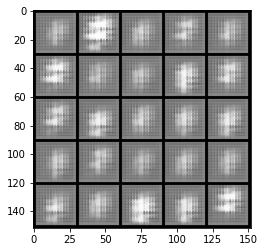

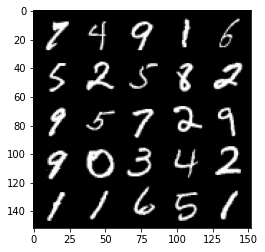

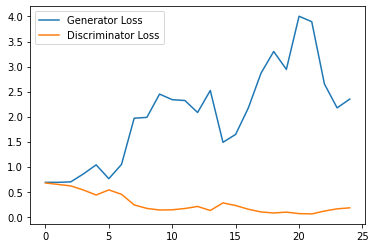

Step 1000: Generator loss: 4.072661755561828, discriminator loss: 0.07035012333095074


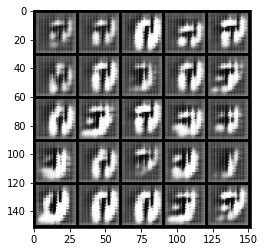

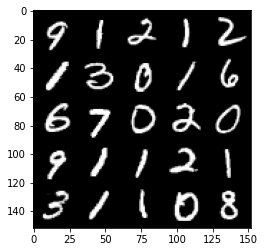

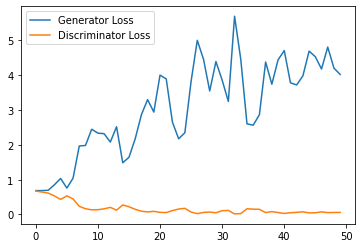

Step 1500: Generator loss: 3.9646213335990907, discriminator loss: 0.07393841887265444


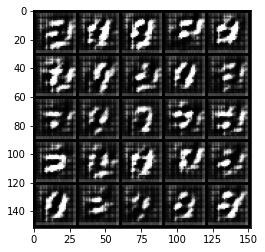

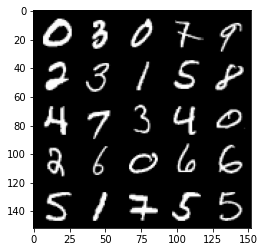

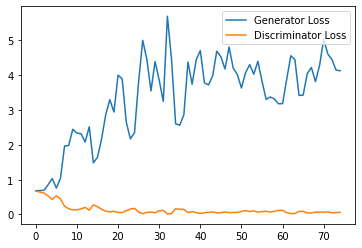

Step 2000: Generator loss: 3.1354908280372618, discriminator loss: 0.17444021520018577


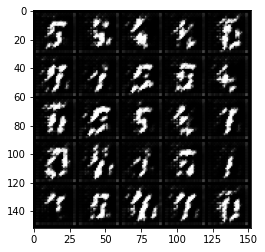

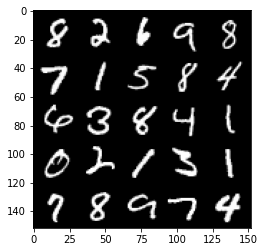

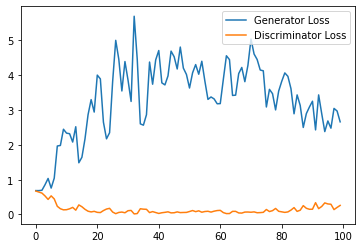

Step 2500: Generator loss: 2.338266696691513, discriminator loss: 0.27748019772768023


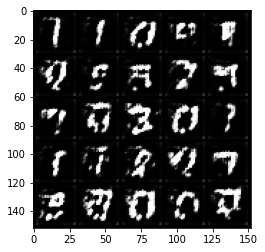

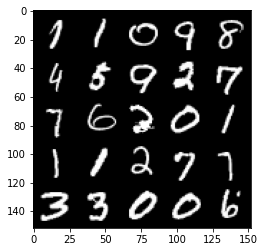

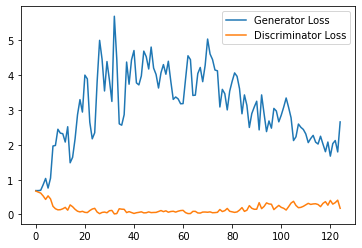

Step 3000: Generator loss: 2.0790507724285128, discriminator loss: 0.3345713053941727


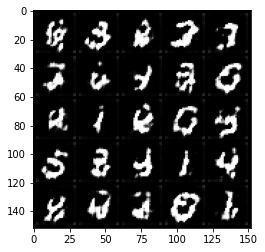

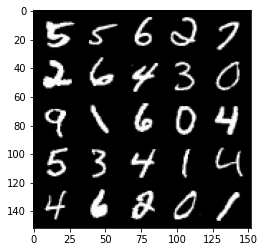

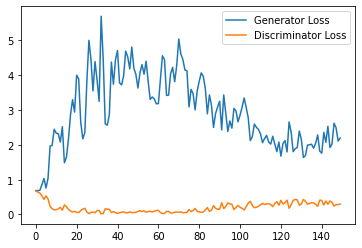

Step 3500: Generator loss: 1.9495914735794067, discriminator loss: 0.347889514029026


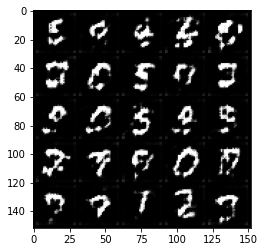

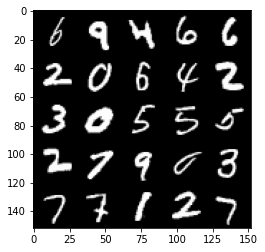

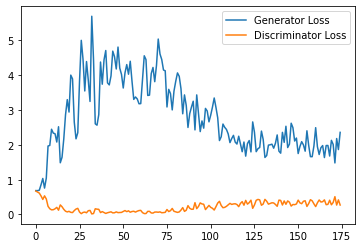

Step 4000: Generator loss: 2.0215216722488405, discriminator loss: 0.37039596822857856


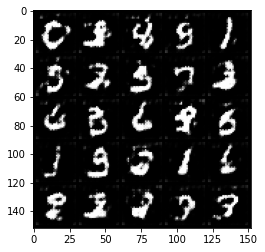

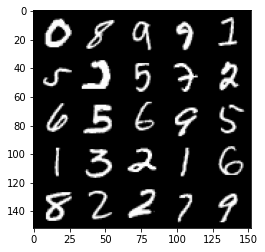

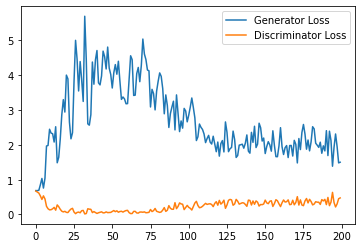

Step 4500: Generator loss: 1.7183058519363403, discriminator loss: 0.3806197048723698


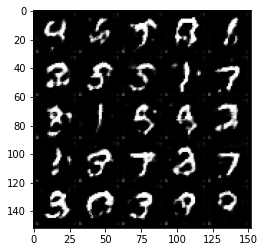

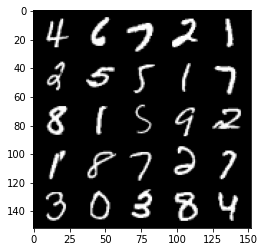

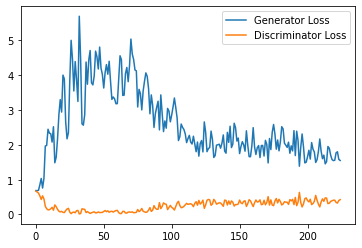

Step 5000: Generator loss: 1.6127730967998504, discriminator loss: 0.4160632143318653


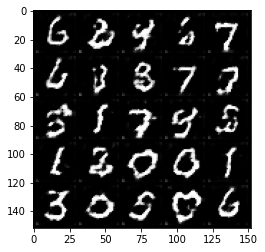

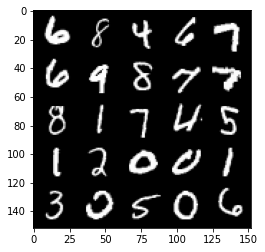

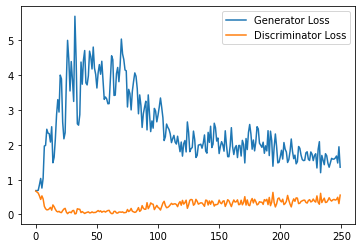

Step 5500: Generator loss: 1.5726086601018905, discriminator loss: 0.43382491677999496


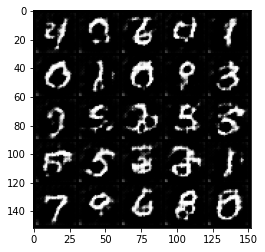

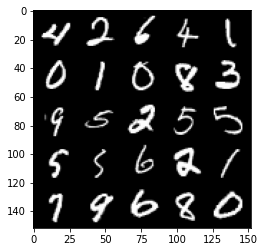

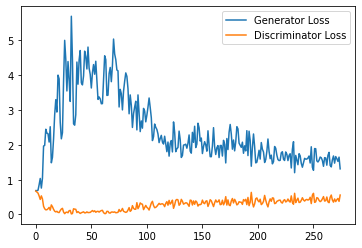

Step 6000: Generator loss: 1.4548372017145157, discriminator loss: 0.45164854037761687


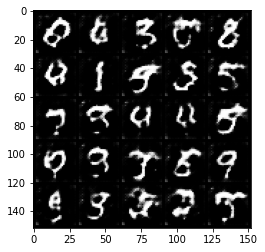

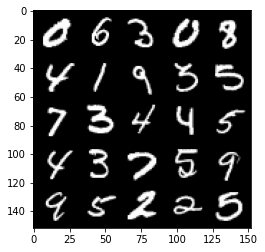

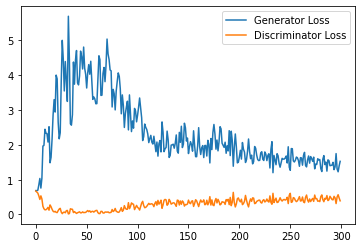

Step 6500: Generator loss: 1.4284776318073273, discriminator loss: 0.470736701965332


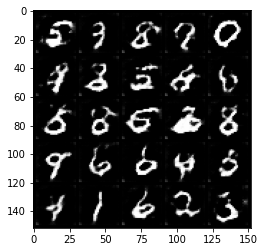

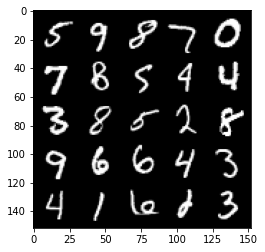

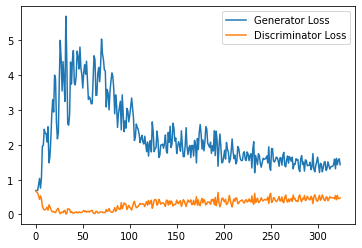

Step 7000: Generator loss: 1.459138899087906, discriminator loss: 0.5002331258058548


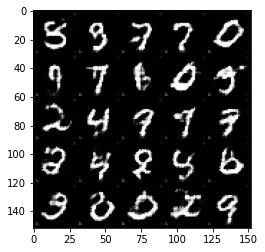

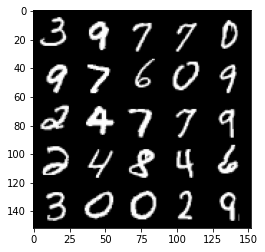

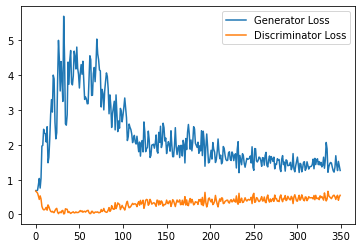

Step 7500: Generator loss: 1.335776023864746, discriminator loss: 0.511263525724411


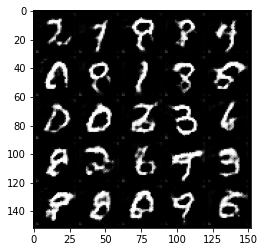

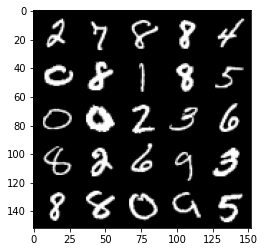

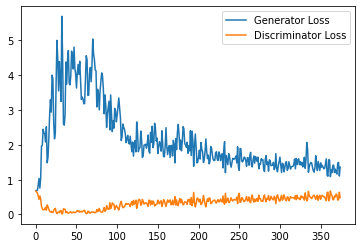

Step 8000: Generator loss: 1.3294004037380218, discriminator loss: 0.4975785192847252


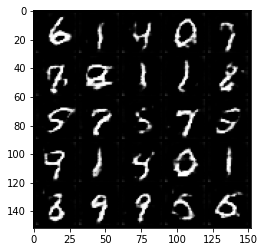

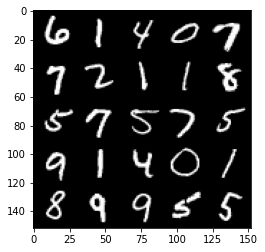

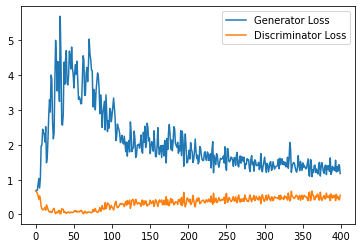

Step 8500: Generator loss: 1.2098773699998855, discriminator loss: 0.5301129766106606


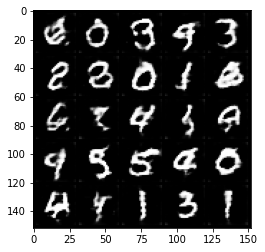

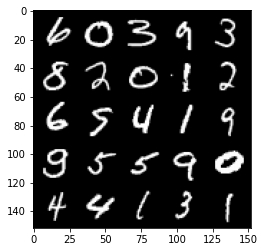

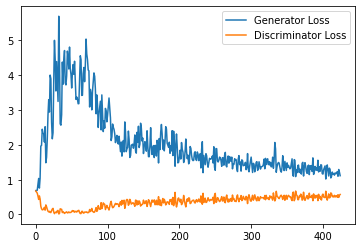

Step 9000: Generator loss: 1.1918594447374344, discriminator loss: 0.5379454774260521


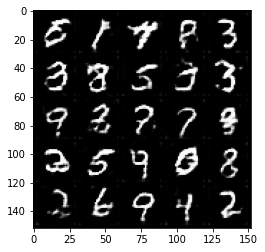

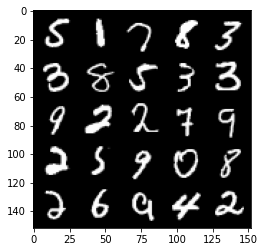

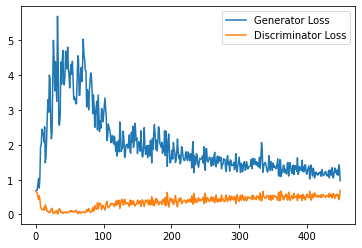

Step 9500: Generator loss: 1.239285773396492, discriminator loss: 0.5462977008819581


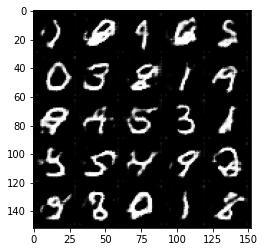

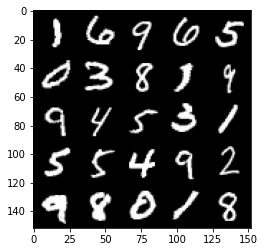

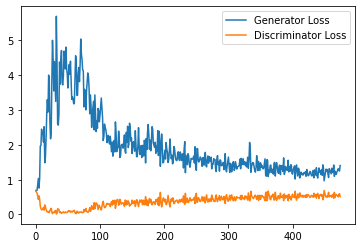

Step 10000: Generator loss: 1.2423060146570206, discriminator loss: 0.5490460326075554


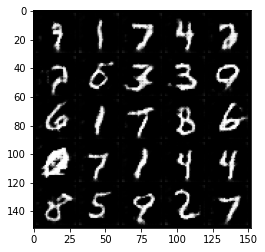

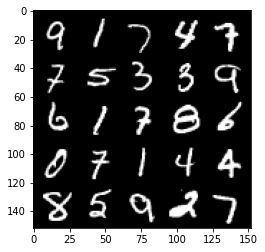

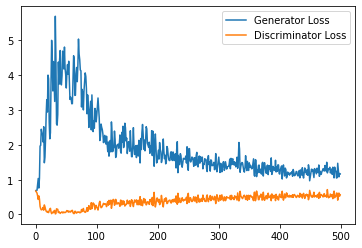

Step 10500: Generator loss: 1.1801496175527573, discriminator loss: 0.5416602280735969


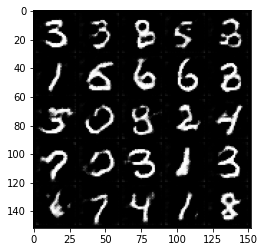

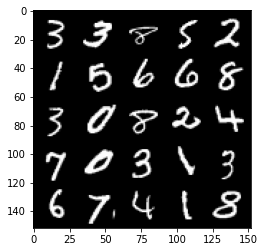

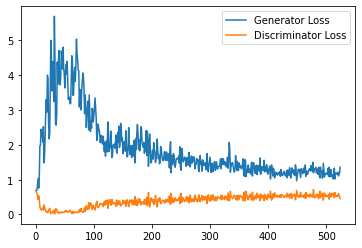

Step 11000: Generator loss: 1.1677483583688737, discriminator loss: 0.5534541648626328


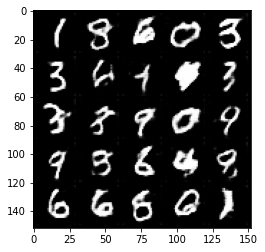

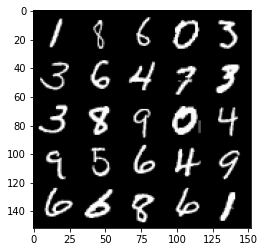

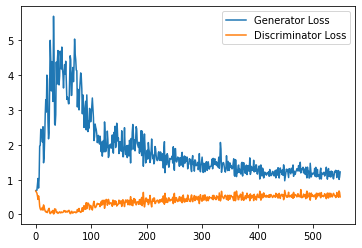

Step 11500: Generator loss: 1.163316525697708, discriminator loss: 0.5543560709953308


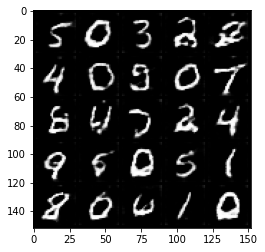

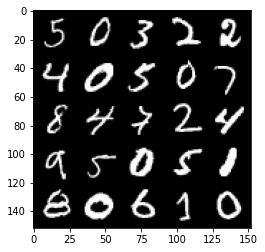

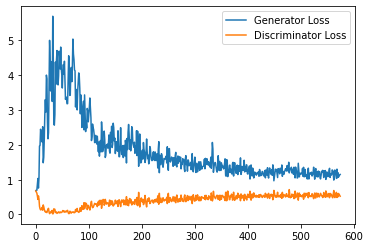

Step 12000: Generator loss: 1.1251853317022324, discriminator loss: 0.558813801407814


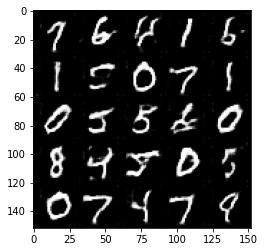

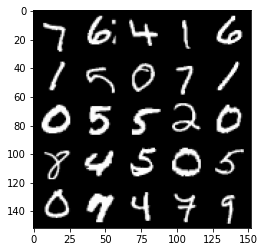

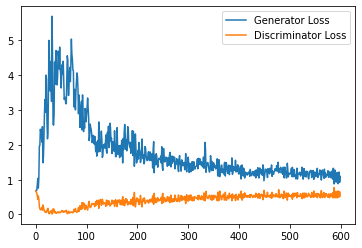

Step 12500: Generator loss: 1.1231949459314345, discriminator loss: 0.5620182502865791


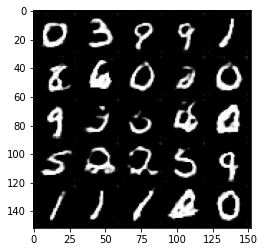

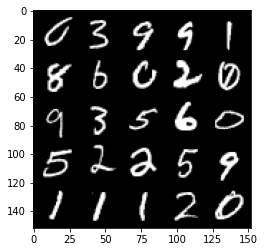

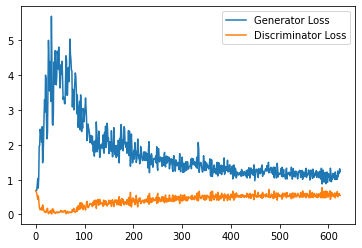

Step 13000: Generator loss: 1.1176819610595703, discriminator loss: 0.5660847924351692


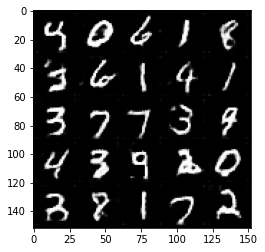

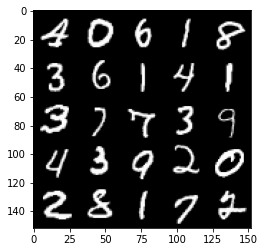

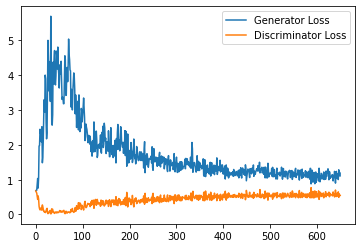

Step 13500: Generator loss: 1.0809868603944779, discriminator loss: 0.5804909532070159


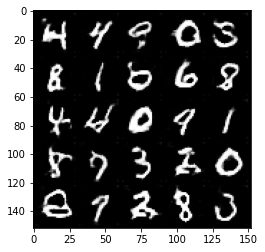

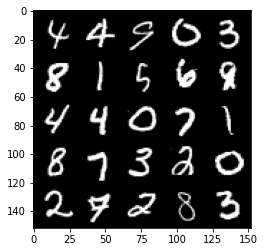

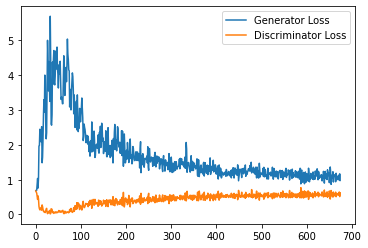

Step 14000: Generator loss: 1.1159906902313232, discriminator loss: 0.5744865101575851


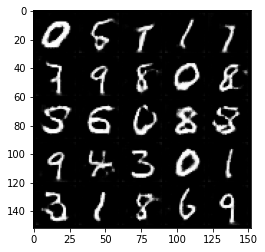

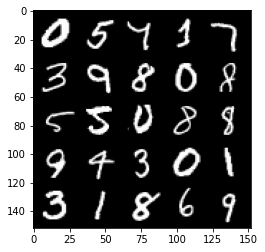

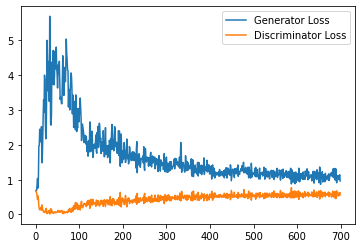

Step 14500: Generator loss: 1.1280552393198013, discriminator loss: 0.5700247870087624


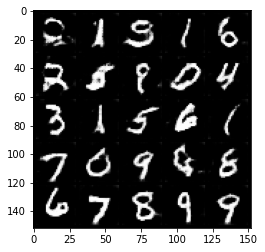

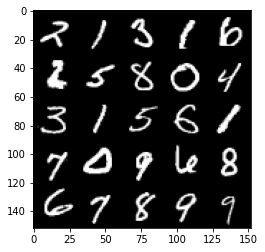

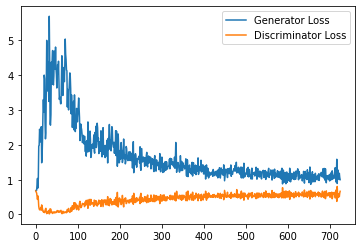

Step 15000: Generator loss: 1.0749132325649262, discriminator loss: 0.5924549279212952


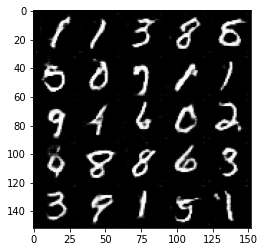

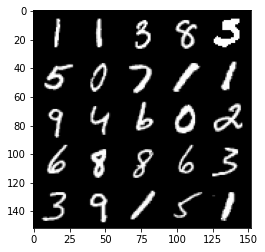

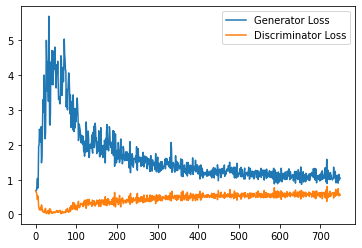

Step 15500: Generator loss: 1.0484931807518005, discriminator loss: 0.6006137369275093


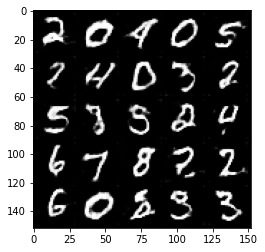

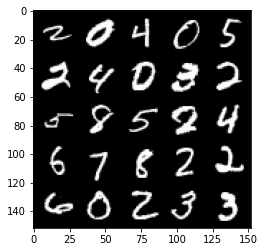

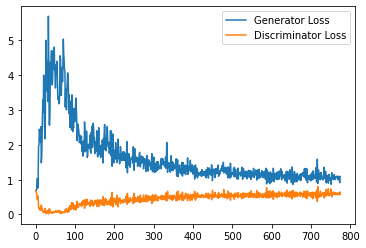

Step 16000: Generator loss: 1.0414729532003402, discriminator loss: 0.5876168324351311


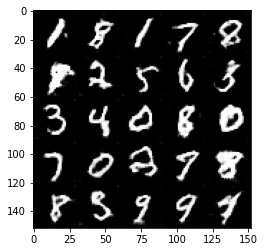

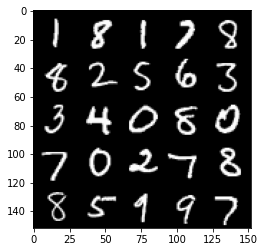

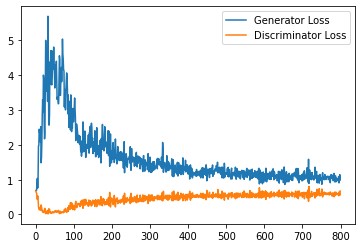

Step 16500: Generator loss: 1.0723967807292938, discriminator loss: 0.5905031564235688


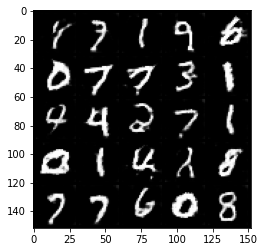

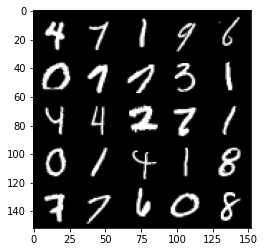

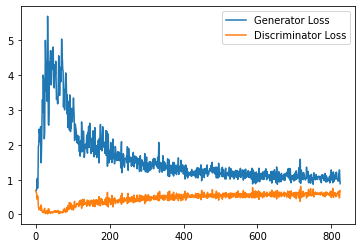

Step 17000: Generator loss: 1.0146147615909575, discriminator loss: 0.5864730197191238


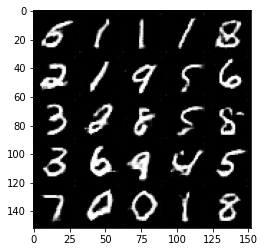

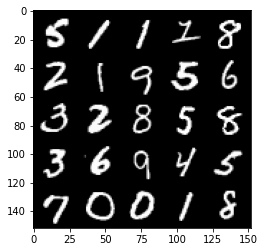

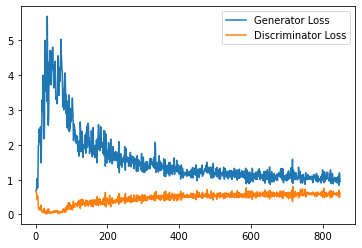

Step 17500: Generator loss: 1.044027944803238, discriminator loss: 0.5886188259124756


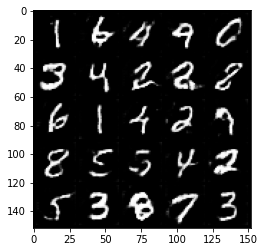

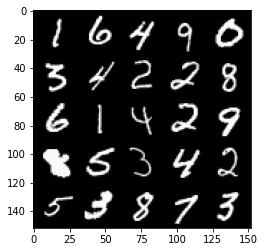

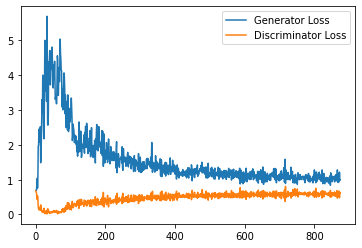

Step 18000: Generator loss: 1.0131546001434326, discriminator loss: 0.600064207315445


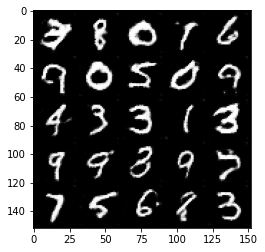

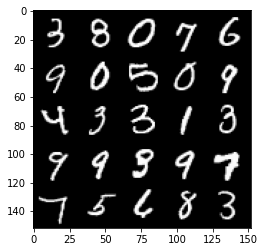

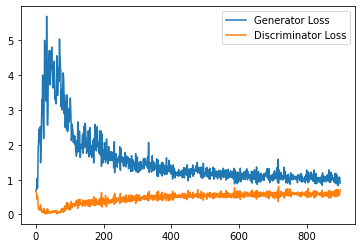

Step 18500: Generator loss: 1.0291134934425354, discriminator loss: 0.5835800231695175


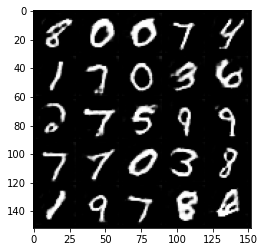

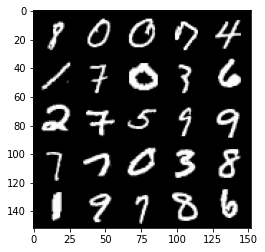

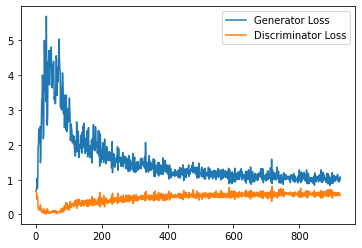

Step 19000: Generator loss: 1.0237262659072877, discriminator loss: 0.5804488219618797


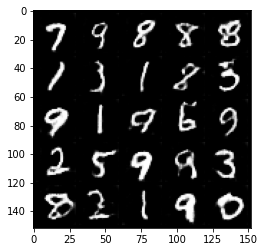

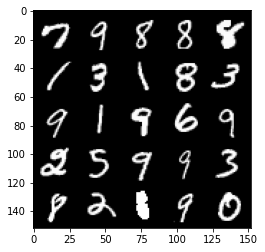

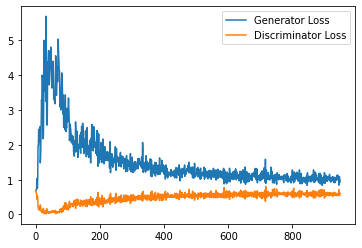

Step 19500: Generator loss: 1.0260156832933427, discriminator loss: 0.5965968967080116


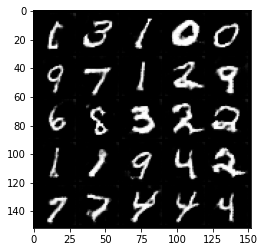

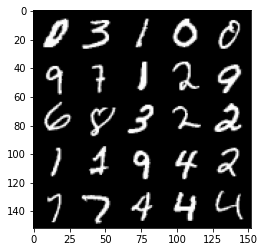

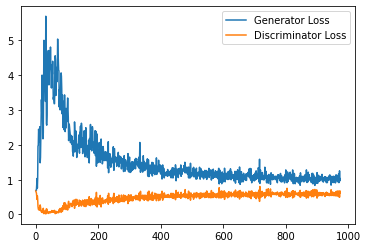

Step 20000: Generator loss: 1.0002861196994781, discriminator loss: 0.5983066194653511


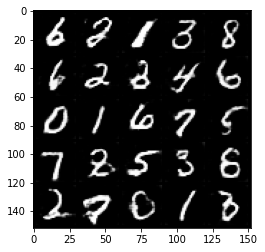

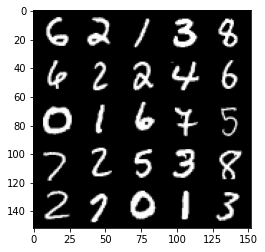

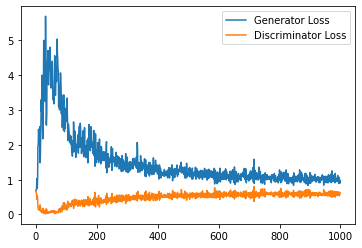

Step 20500: Generator loss: 1.049650048136711, discriminator loss: 0.5894694750905037


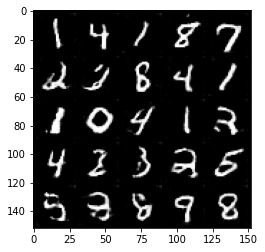

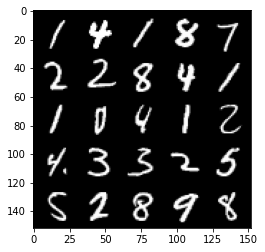

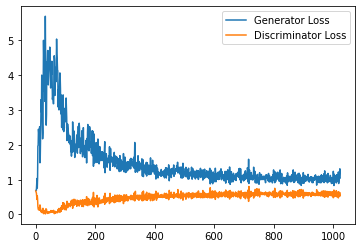

Step 21000: Generator loss: 1.014810382604599, discriminator loss: 0.5888027880787849


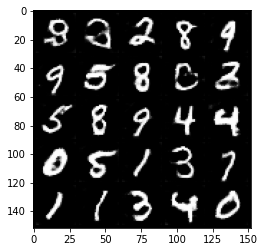

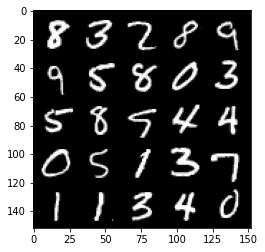

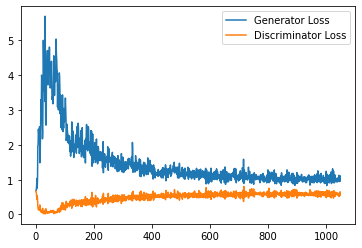

Step 21500: Generator loss: 1.0275537003278732, discriminator loss: 0.5854818421602249


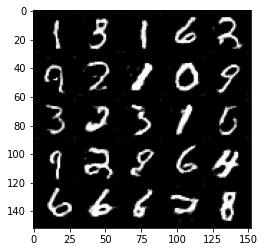

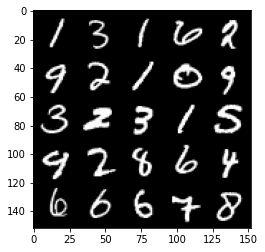

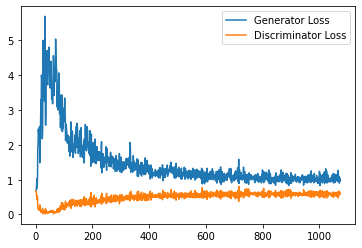

Step 22000: Generator loss: 1.0252990816831589, discriminator loss: 0.5884378504157066


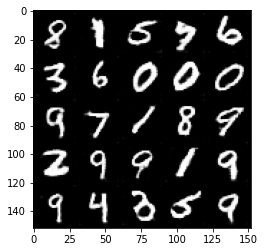

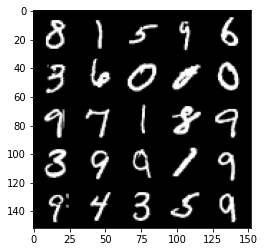

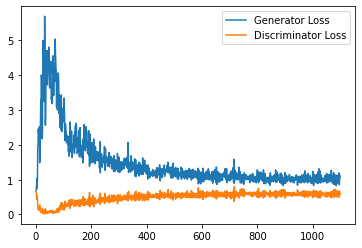

Step 22500: Generator loss: 1.058904897093773, discriminator loss: 0.5856139912605286


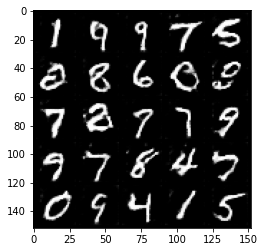

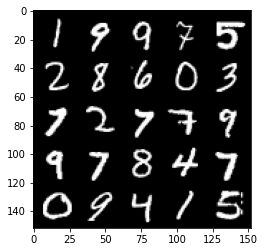

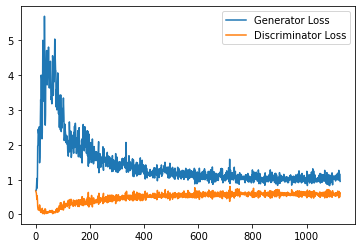

Step 23000: Generator loss: 1.0474435489177705, discriminator loss: 0.581143880546093


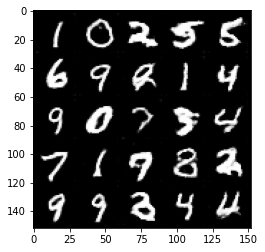

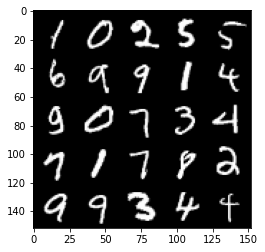

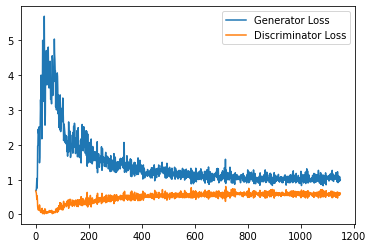

Step 23500: Generator loss: 1.012858444571495, discriminator loss: 0.586658987402916


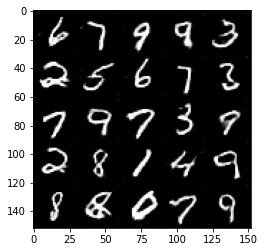

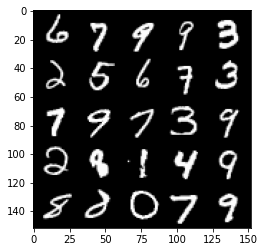

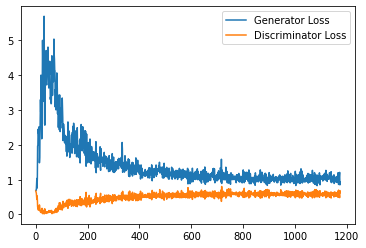

Step 24000: Generator loss: 1.0437186900377273, discriminator loss: 0.5809312007427215


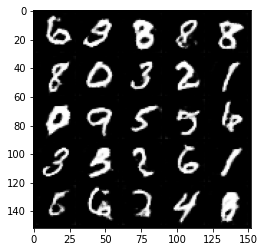

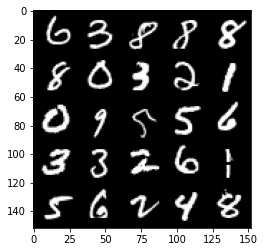

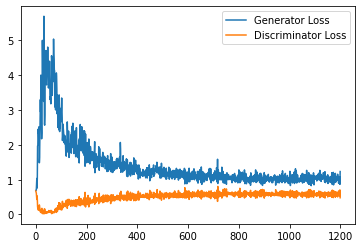

Step 24500: Generator loss: 1.0016256005764008, discriminator loss: 0.58790837007761


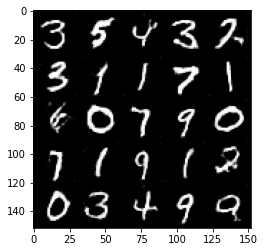

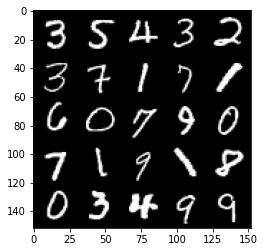

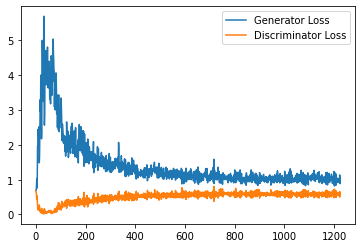

Step 25000: Generator loss: 1.0092558487653733, discriminator loss: 0.5818743882775307


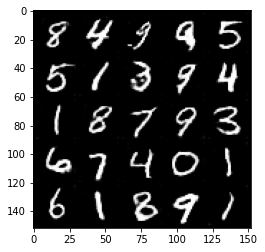

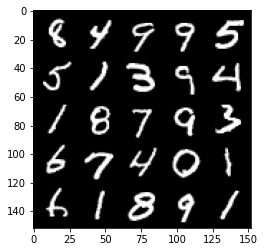

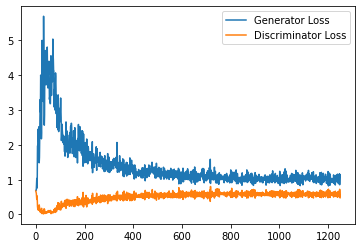

Step 25500: Generator loss: 1.0311098494529725, discriminator loss: 0.5834872762560844


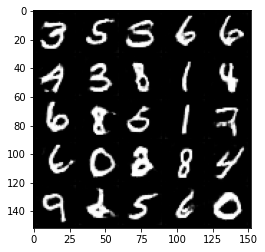

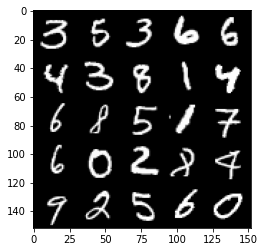

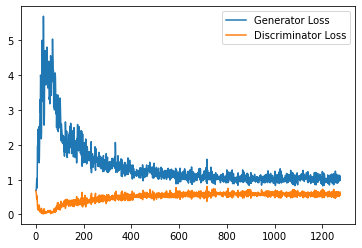

Step 26000: Generator loss: 1.0350575789213181, discriminator loss: 0.5779883598685265


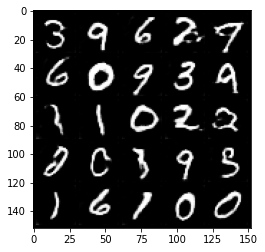

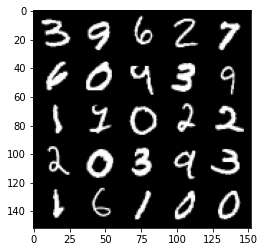

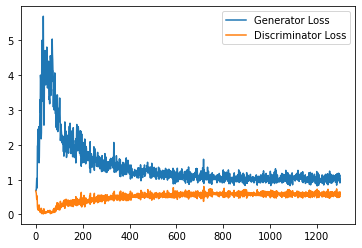

Step 26500: Generator loss: 1.0361399372816087, discriminator loss: 0.57591548037529


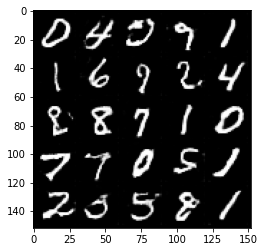

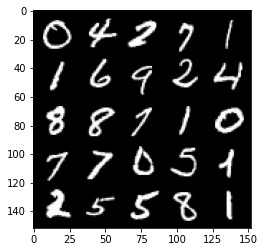

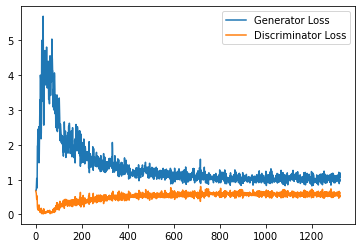

Step 27000: Generator loss: 1.0270001215934754, discriminator loss: 0.5837362359166145


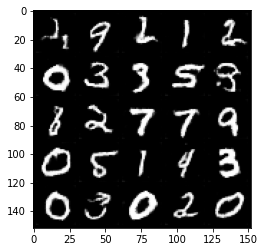

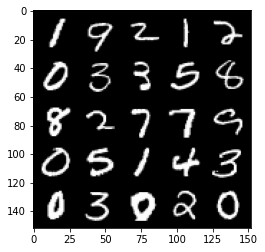

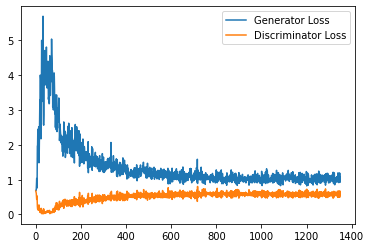

Step 27500: Generator loss: 1.0140994539260864, discriminator loss: 0.5787623957395553


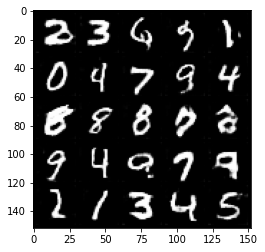

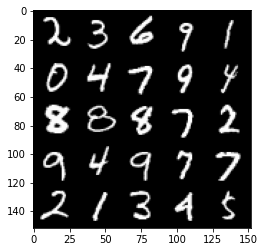

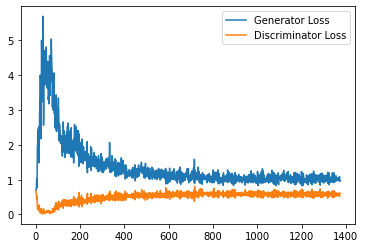

Step 28000: Generator loss: 1.0048342233896255, discriminator loss: 0.5863695519566536


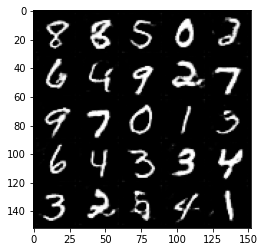

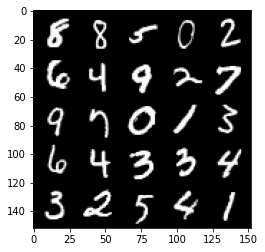

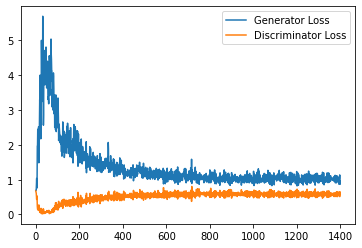

Step 28500: Generator loss: 1.0173692022562026, discriminator loss: 0.5760988624691963


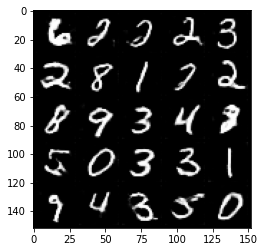

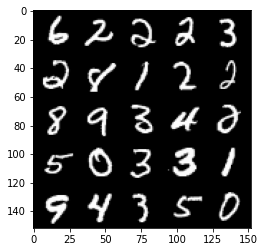

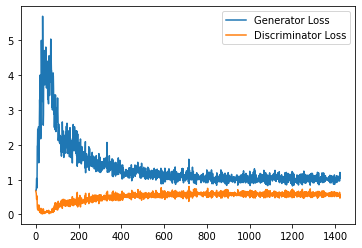

Step 29000: Generator loss: 1.0084133409261704, discriminator loss: 0.5845272610187531


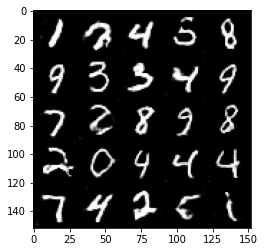

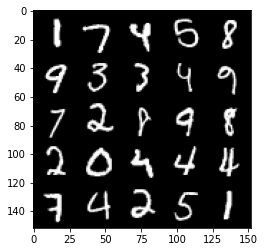

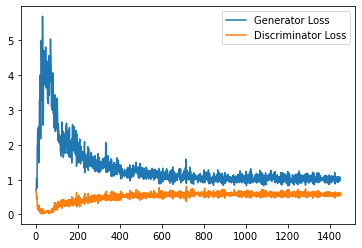

Step 29500: Generator loss: 1.0247415821552277, discriminator loss: 0.5846902886033059


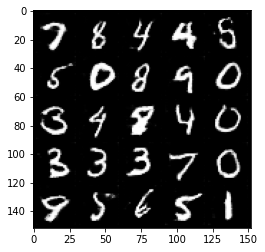

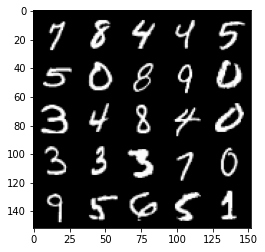

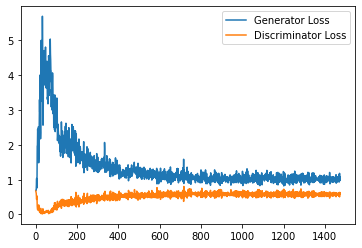

Step 30000: Generator loss: 1.0336190487146377, discriminator loss: 0.582051611840725


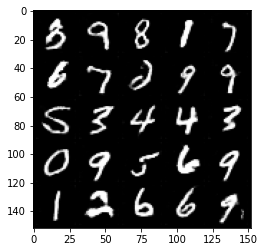

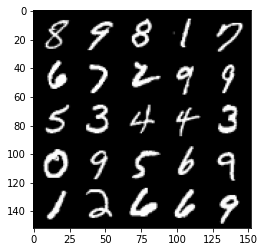

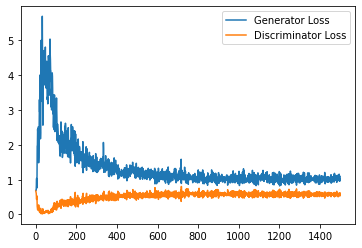

Step 30500: Generator loss: 1.015011026263237, discriminator loss: 0.5803424382805824


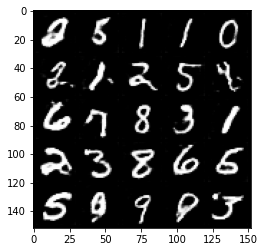

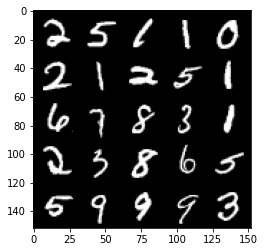

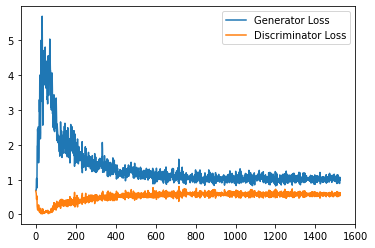

Step 31000: Generator loss: 1.0128972936868668, discriminator loss: 0.5791860938668251


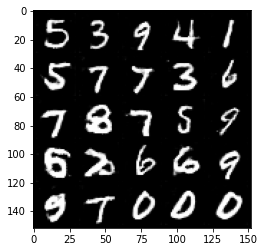

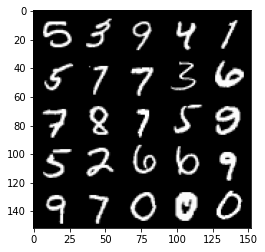

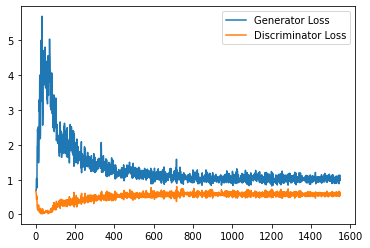

Step 31500: Generator loss: 1.0362441530227662, discriminator loss: 0.5827589011192322


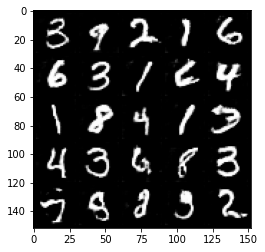

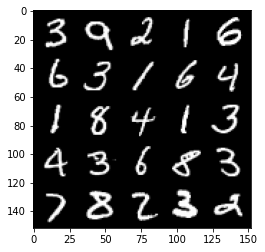

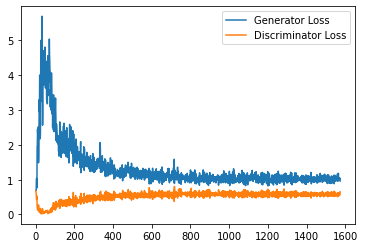

Step 32000: Generator loss: 1.0452928409576416, discriminator loss: 0.5778007075786591


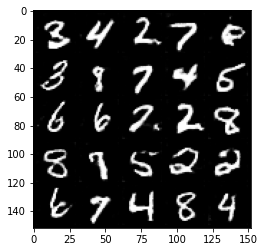

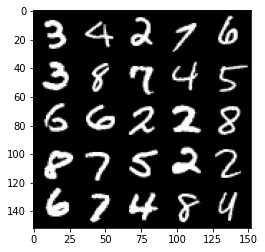

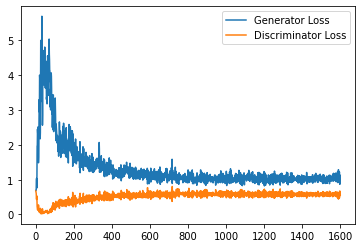

Step 32500: Generator loss: 1.0308858798742295, discriminator loss: 0.5799617078304291


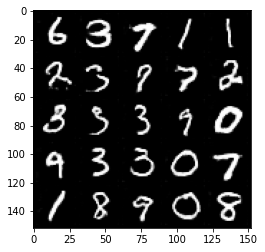

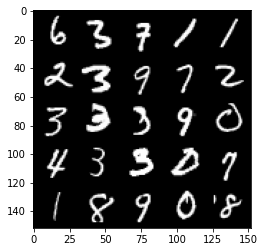

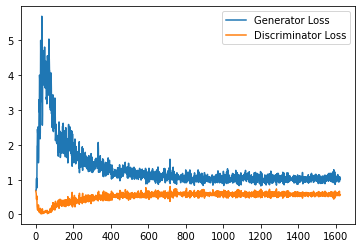

Step 33000: Generator loss: 1.0271749175786973, discriminator loss: 0.577166604578495


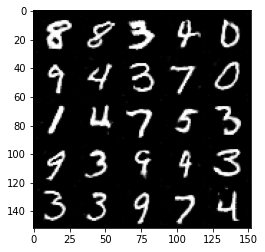

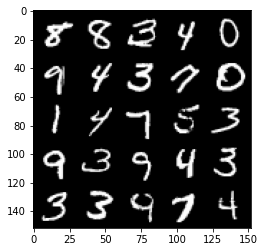

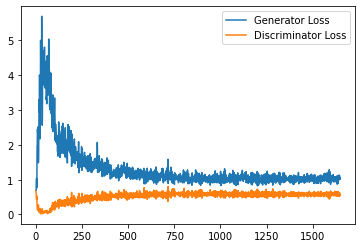

Step 33500: Generator loss: 1.0196327291727065, discriminator loss: 0.5823077518343925


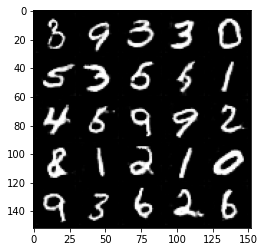

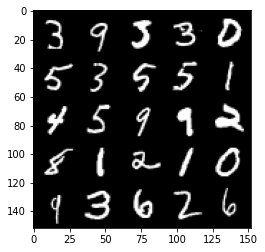

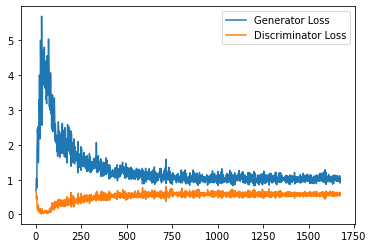

Step 34000: Generator loss: 1.0435325922966003, discriminator loss: 0.5749711664319038


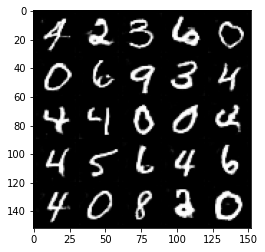

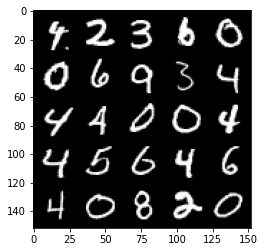

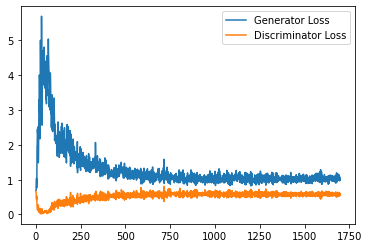

Step 34500: Generator loss: 1.0513697426319122, discriminator loss: 0.5740189522504806


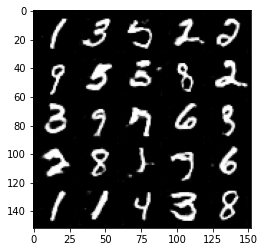

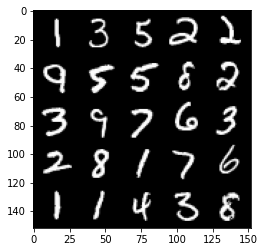

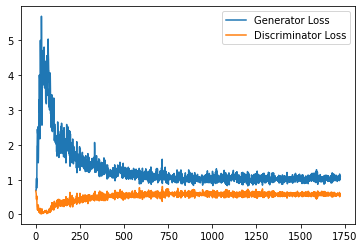

Step 35000: Generator loss: 1.0330327899456024, discriminator loss: 0.5770289871096611


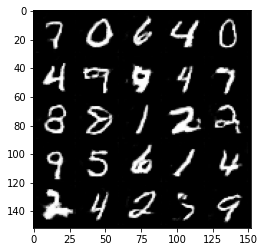

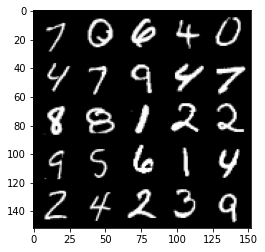

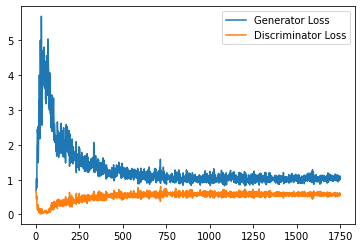

Step 35500: Generator loss: 1.0696196442842483, discriminator loss: 0.5793040329813958


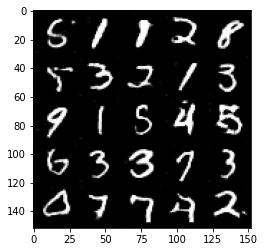

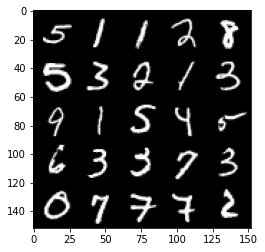

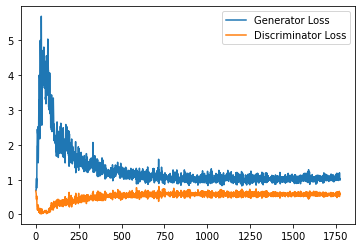

Step 36000: Generator loss: 1.0179031546115875, discriminator loss: 0.576138209939003


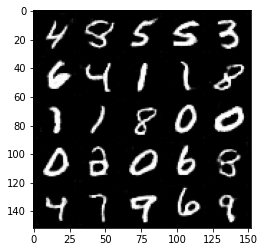

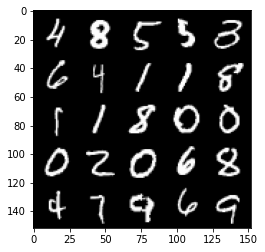

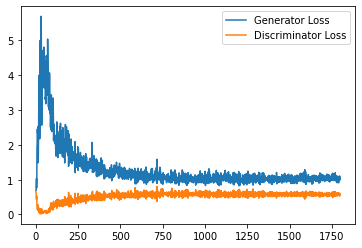

Step 36500: Generator loss: 1.026327044725418, discriminator loss: 0.5758009695410728


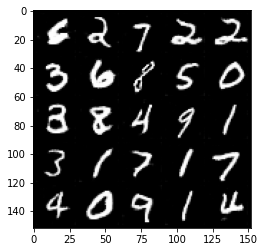

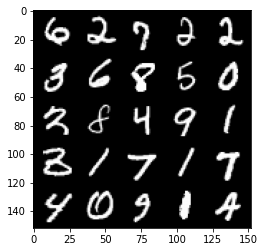

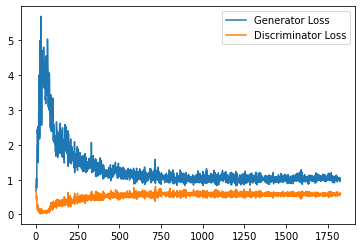

Step 37000: Generator loss: 1.0666265540122986, discriminator loss: 0.5710389967560768


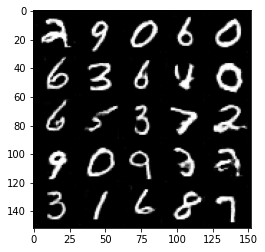

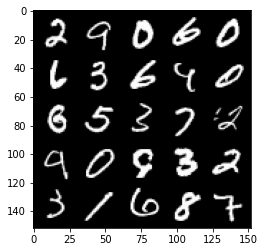

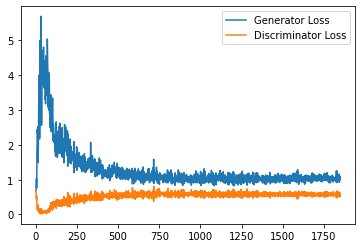

Step 37500: Generator loss: 1.025777937054634, discriminator loss: 0.5755321230292321


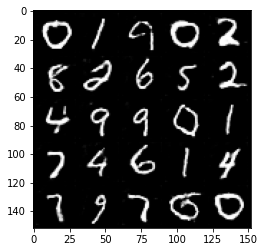

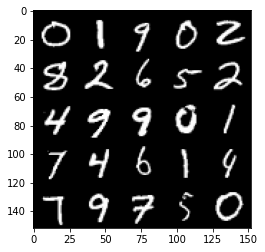

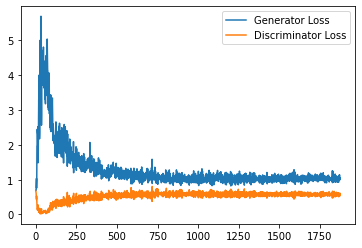

Step 38000: Generator loss: 1.0242448921203613, discriminator loss: 0.5744339668750763


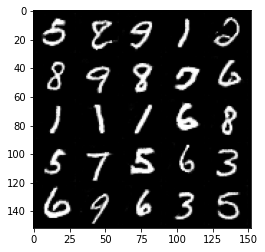

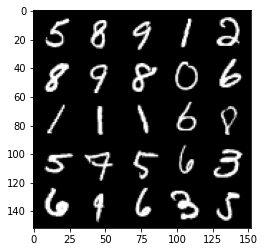

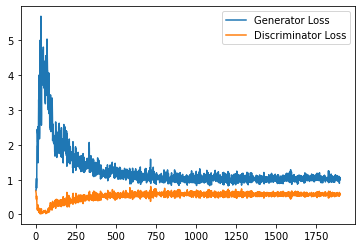

Step 38500: Generator loss: 1.0369885890483856, discriminator loss: 0.5705509735345841


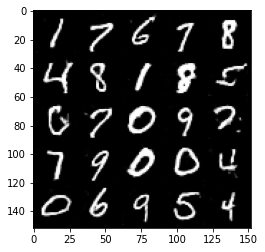

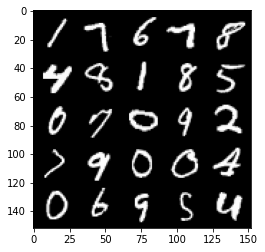

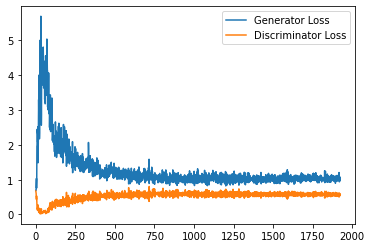

Step 39000: Generator loss: 1.0460409376621247, discriminator loss: 0.5768340989351273


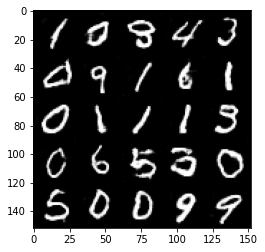

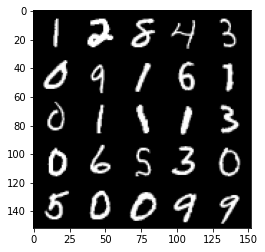

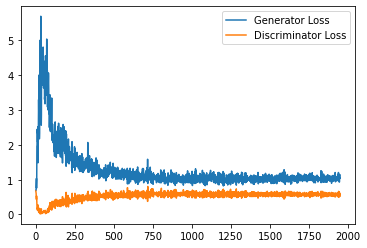

Step 39500: Generator loss: 1.0655023695230483, discriminator loss: 0.5716790903806687


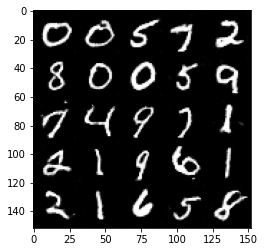

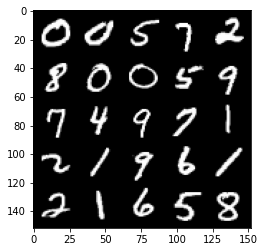

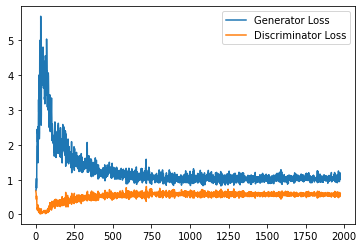

Step 40000: Generator loss: 1.0381753652095795, discriminator loss: 0.5713215326666832


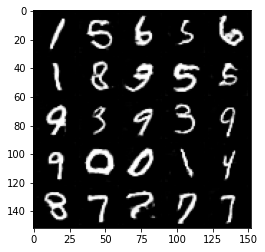

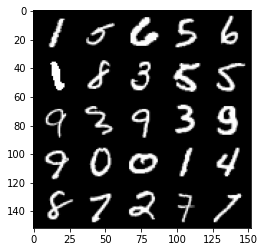

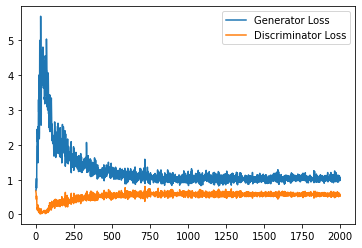

Step 40500: Generator loss: 1.0370596927404403, discriminator loss: 0.5726915291547775


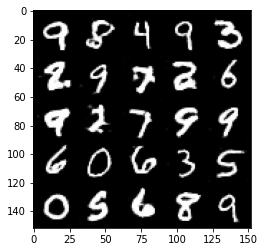

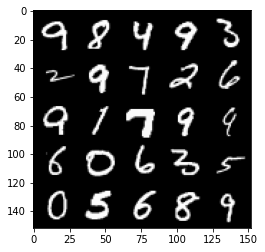

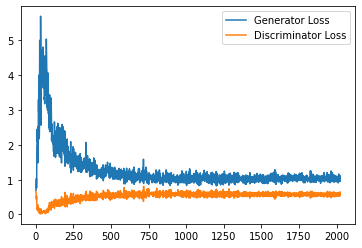

Step 41000: Generator loss: 1.0421976655721665, discriminator loss: 0.5688726457953454


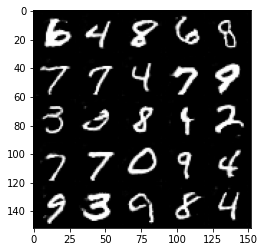

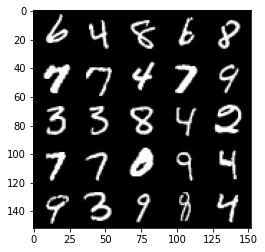

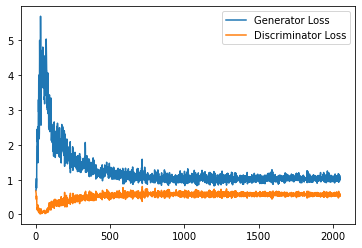

Step 41500: Generator loss: 1.0329370611906052, discriminator loss: 0.5772361364960671


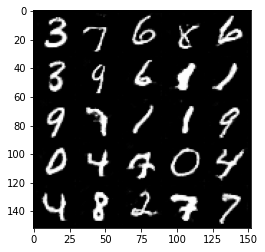

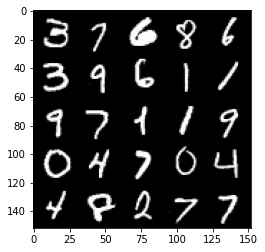

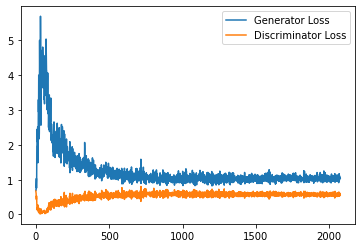

Step 42000: Generator loss: 1.0242155648469924, discriminator loss: 0.5723612132072449


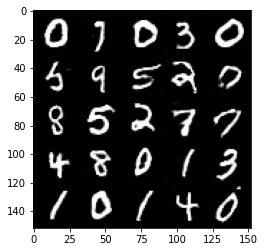

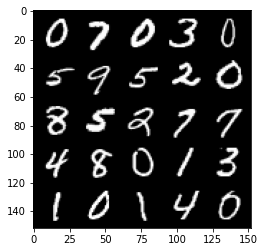

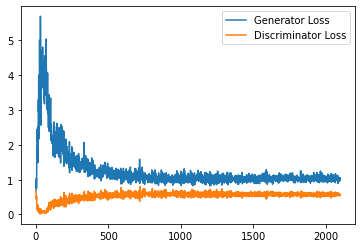

Step 42500: Generator loss: 1.050609209895134, discriminator loss: 0.5729129955768585


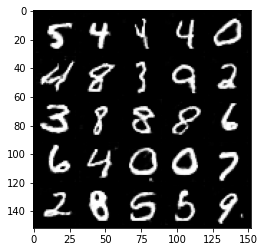

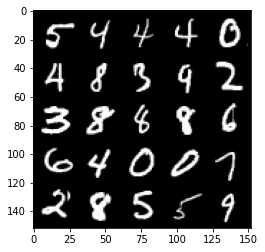

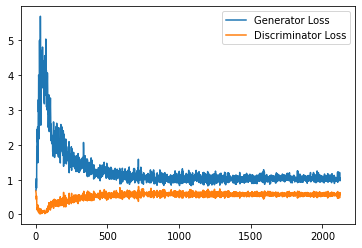

Step 43000: Generator loss: 1.0364285452365876, discriminator loss: 0.5738667596578598


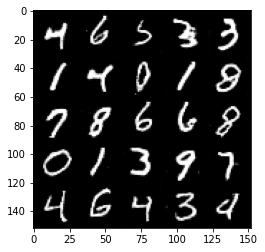

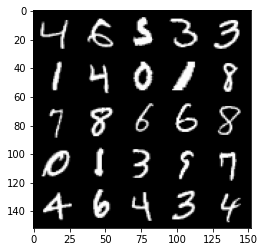

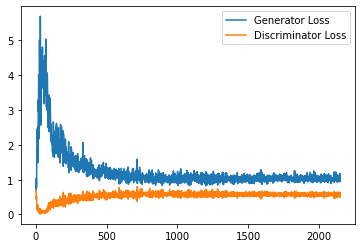

Step 43500: Generator loss: 1.0556359388828278, discriminator loss: 0.5665259637236595


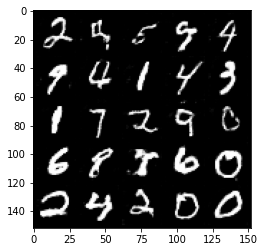

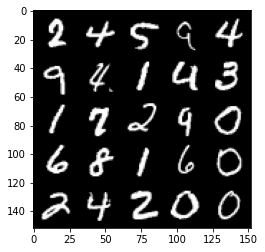

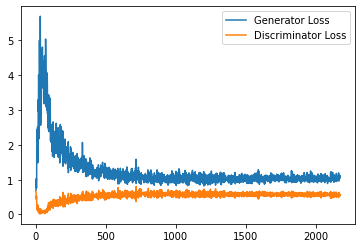

Step 44000: Generator loss: 1.0502103718519211, discriminator loss: 0.5800457121729851


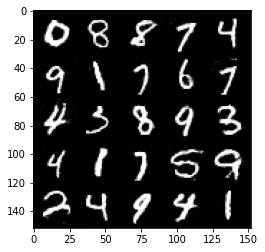

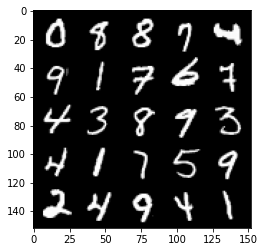

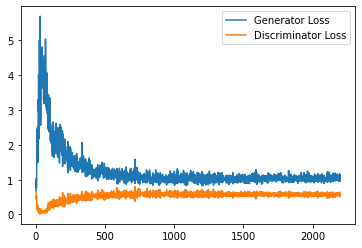

Step 44500: Generator loss: 1.053966886639595, discriminator loss: 0.5747544630765915


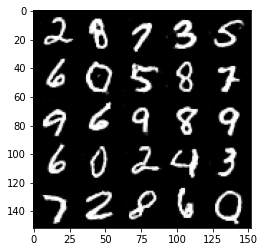

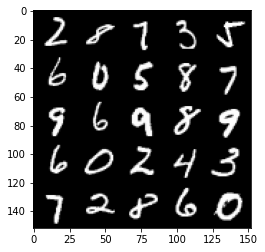

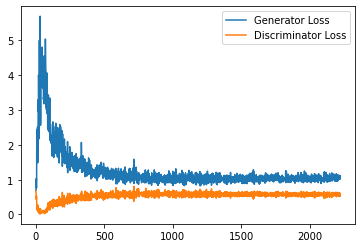

Step 45000: Generator loss: 1.042646166086197, discriminator loss: 0.5744859148859978


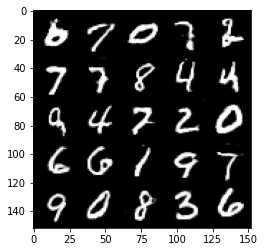

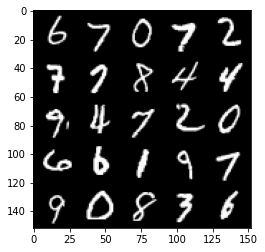

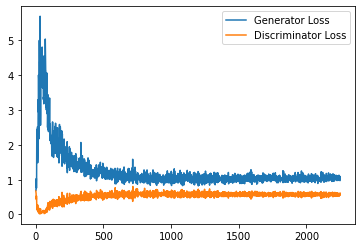

Step 45500: Generator loss: 1.046685119509697, discriminator loss: 0.5680256299972534


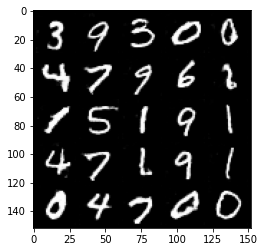

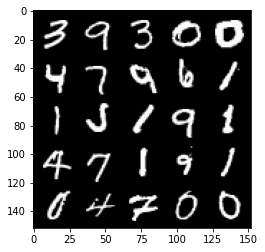

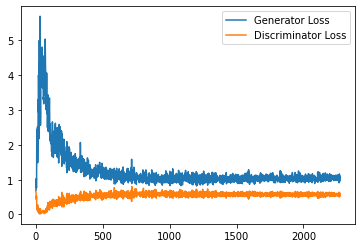

Step 46000: Generator loss: 1.0437414890527725, discriminator loss: 0.5728919399976731


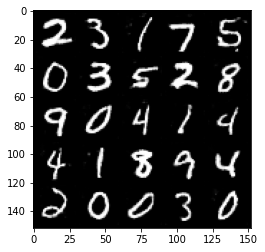

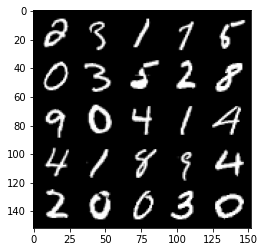

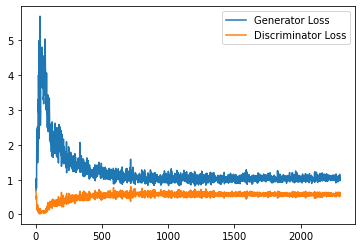

Step 46500: Generator loss: 1.0526309329271317, discriminator loss: 0.5728231426477433


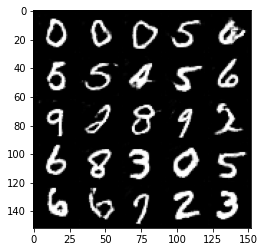

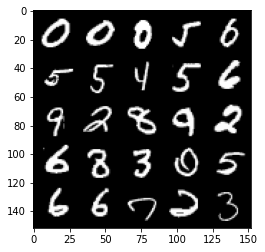

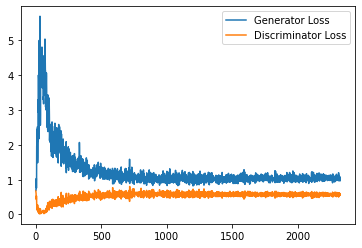

Step 47000: Generator loss: 1.0281374677419663, discriminator loss: 0.5706613750457764


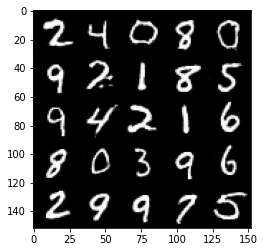

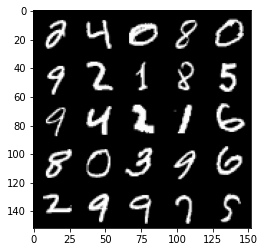

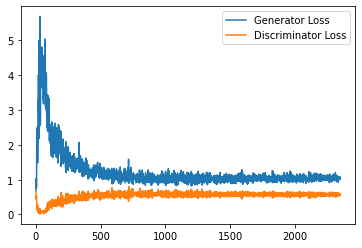

Step 47500: Generator loss: 1.0249524443149567, discriminator loss: 0.5755136430859565


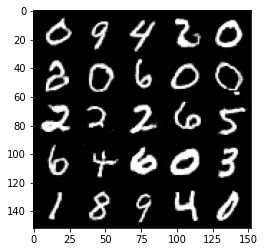

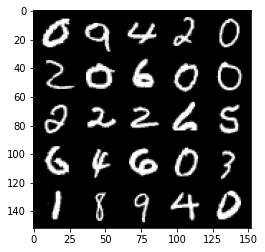

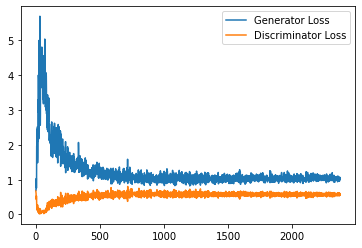

Step 48000: Generator loss: 1.0445225423574447, discriminator loss: 0.572977633535862


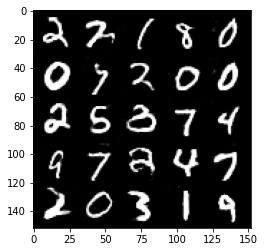

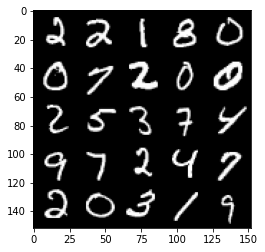

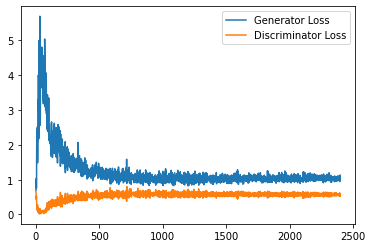

Step 48500: Generator loss: 1.030293779373169, discriminator loss: 0.5762170718312264


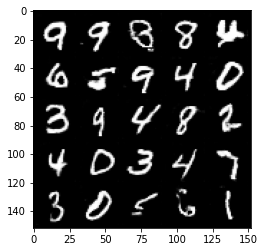

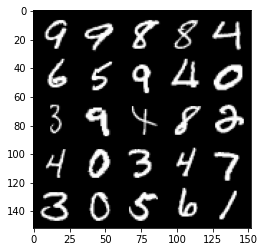

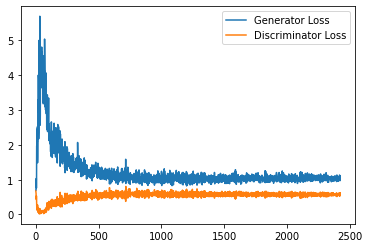

Step 49000: Generator loss: 1.0533217178583145, discriminator loss: 0.5740460036993027


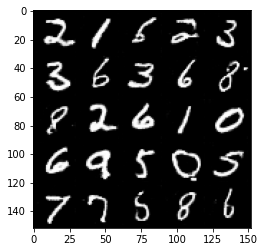

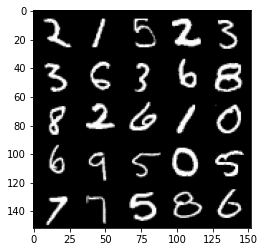

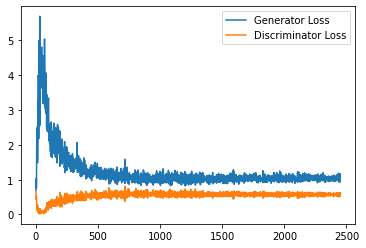

Step 49500: Generator loss: 1.0456903734207152, discriminator loss: 0.5768466482758522


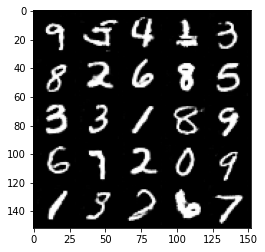

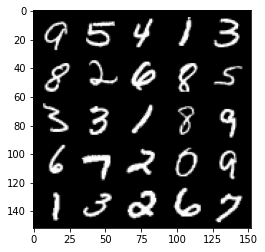

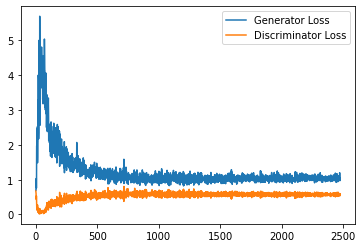

Step 50000: Generator loss: 1.0335791350603103, discriminator loss: 0.5691124479174614


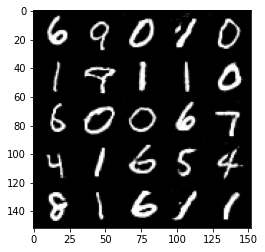

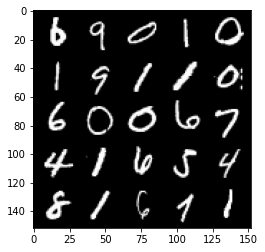

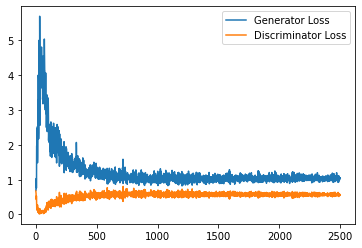

Step 50500: Generator loss: 1.0478326317071915, discriminator loss: 0.5760273688435554


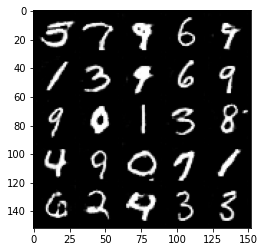

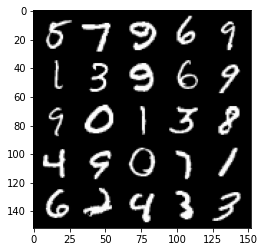

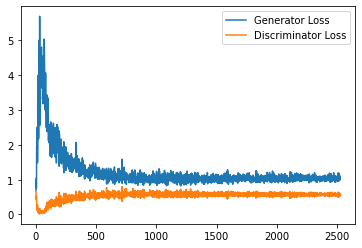

Step 51000: Generator loss: 1.0405840990543365, discriminator loss: 0.5738120831847191


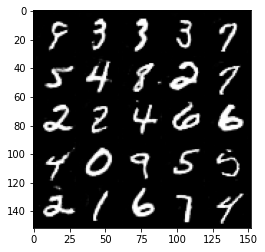

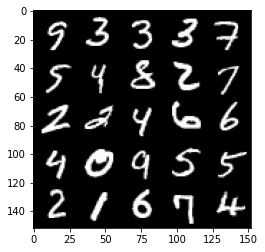

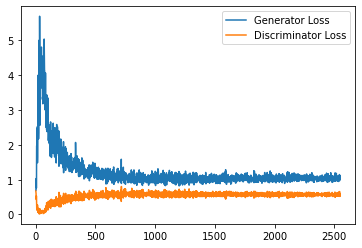

Step 51500: Generator loss: 1.042887561917305, discriminator loss: 0.5690251358747482


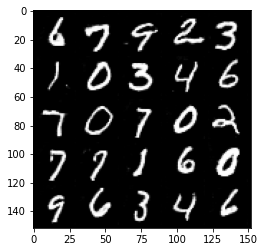

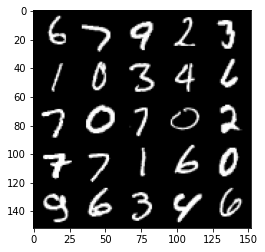

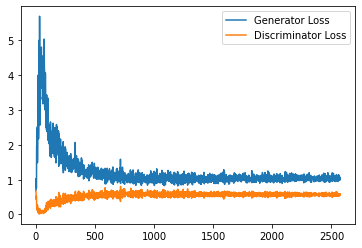

Step 52000: Generator loss: 1.0456077464818954, discriminator loss: 0.5714088829159737


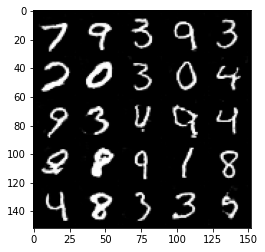

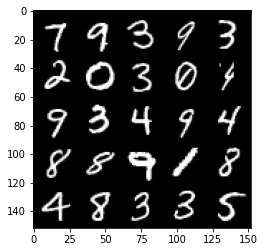

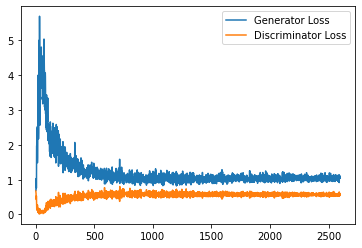

Step 52500: Generator loss: 1.0422122282981872, discriminator loss: 0.5730722788572311


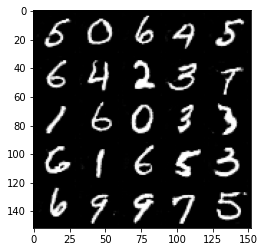

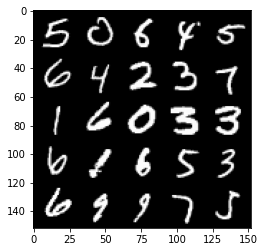

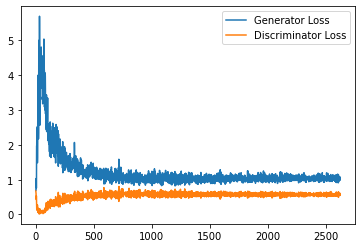

Step 53000: Generator loss: 1.047484920144081, discriminator loss: 0.5766160696744919


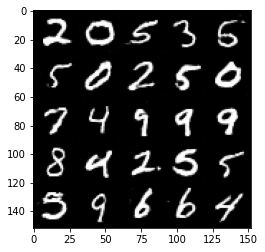

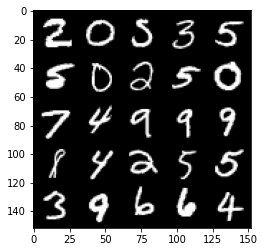

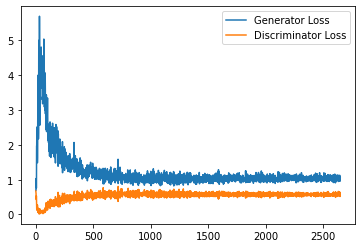

Step 53500: Generator loss: 1.0340738240480423, discriminator loss: 0.5748342202305794


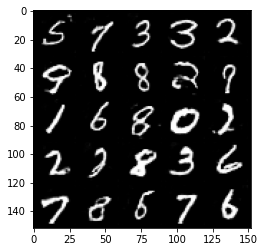

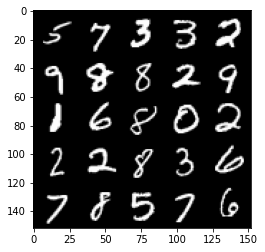

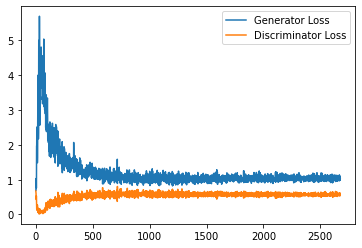

Step 54000: Generator loss: 1.0383443071842193, discriminator loss: 0.5788018426895142


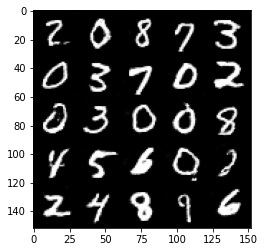

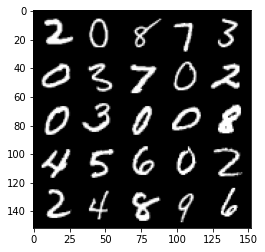

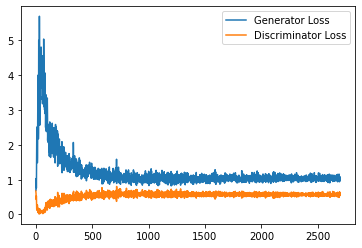

Step 54500: Generator loss: 1.0409806811809539, discriminator loss: 0.5752042828798294


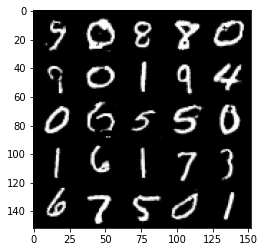

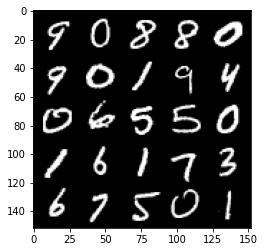

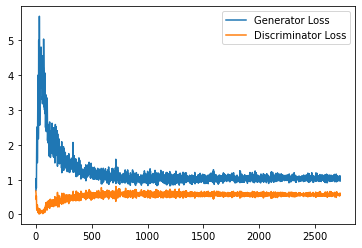

Step 55000: Generator loss: 1.0427801264524459, discriminator loss: 0.5717891550660134


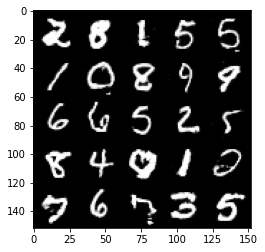

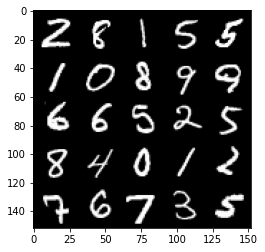

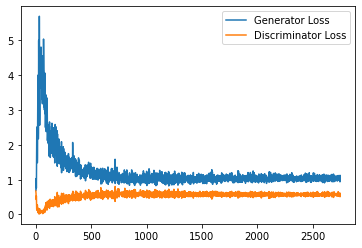

Step 55500: Generator loss: 1.0362704418897628, discriminator loss: 0.5751018099784851


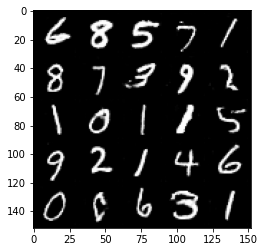

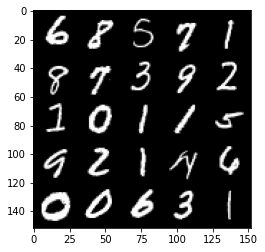

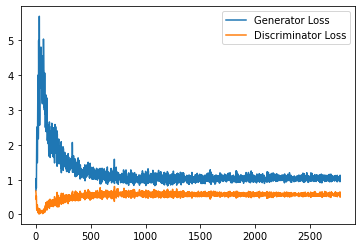

Step 56000: Generator loss: 1.0546503635644913, discriminator loss: 0.5832502701282501


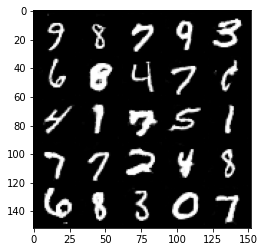

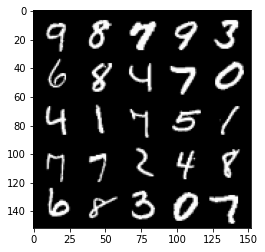

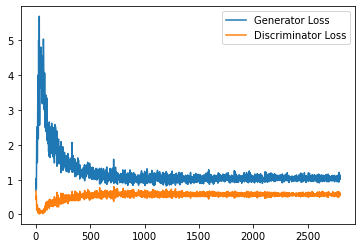

Step 56500: Generator loss: 1.044429636001587, discriminator loss: 0.5769270049333572


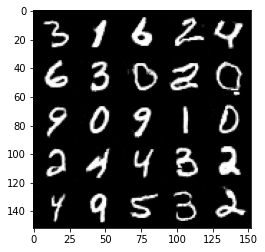

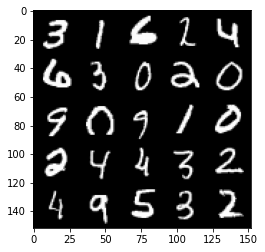

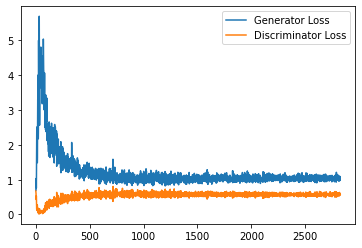

Step 57000: Generator loss: 1.0497633372545243, discriminator loss: 0.574980908036232


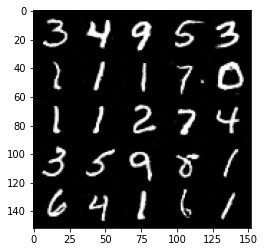

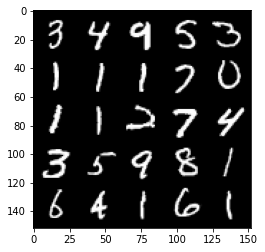

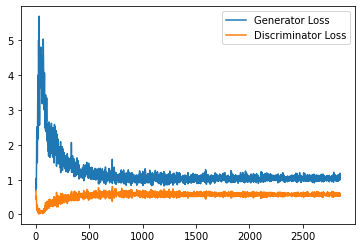

Step 57500: Generator loss: 1.0424077990055085, discriminator loss: 0.5746772184371948


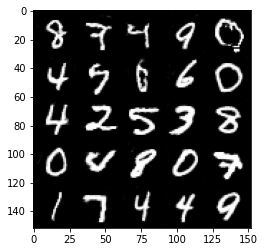

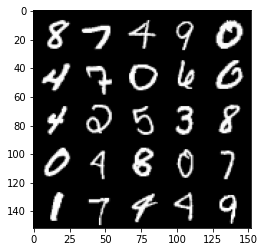

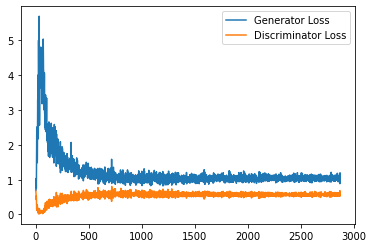

Step 58000: Generator loss: 1.0335987864732743, discriminator loss: 0.5758769606351852


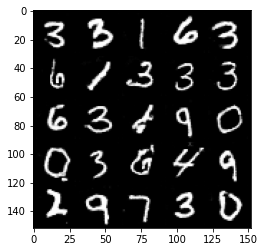

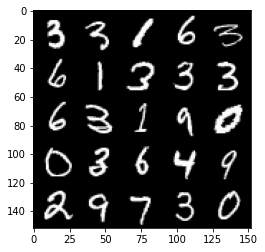

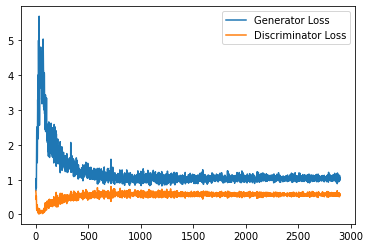

Step 58500: Generator loss: 1.0529857224225998, discriminator loss: 0.5761927858591079


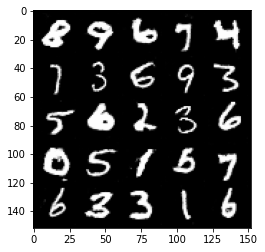

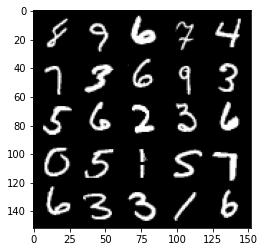

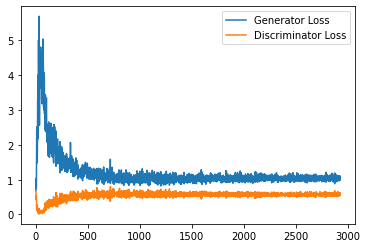

Step 59000: Generator loss: 1.0542685228586197, discriminator loss: 0.5766079497933387


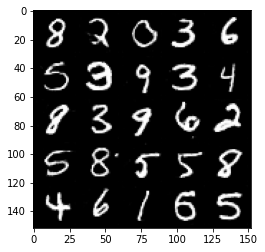

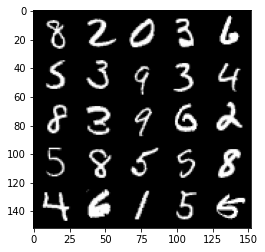

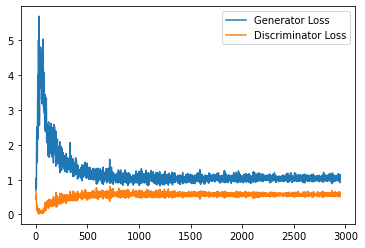

Step 59500: Generator loss: 1.0478538180589676, discriminator loss: 0.5748472626209259


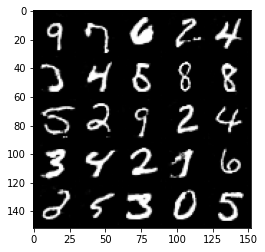

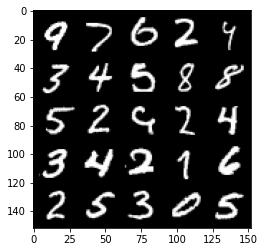

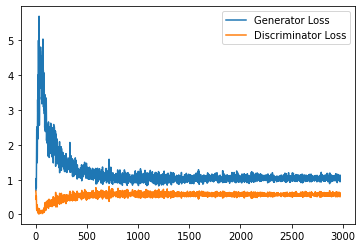

Step 60000: Generator loss: 1.0518641842603684, discriminator loss: 0.5817240213155747


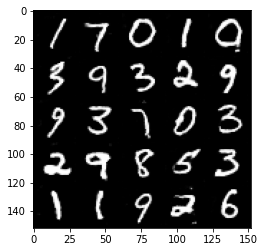

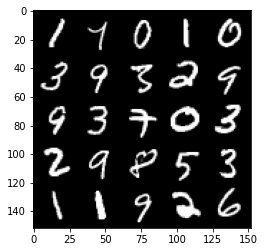

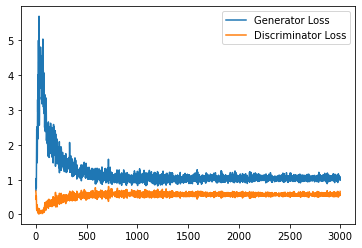

Step 60500: Generator loss: 1.0498292661905289, discriminator loss: 0.5740714907050133


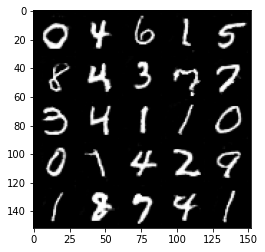

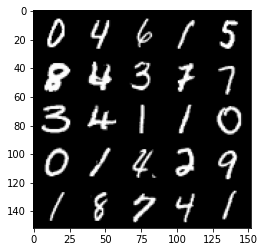

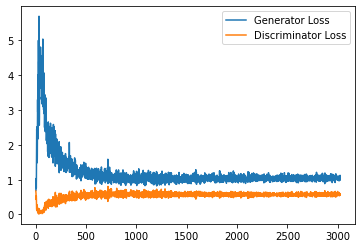

Step 61000: Generator loss: 1.0538141069412232, discriminator loss: 0.5722649911642075


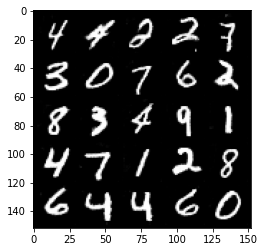

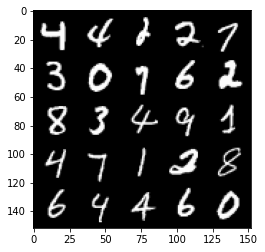

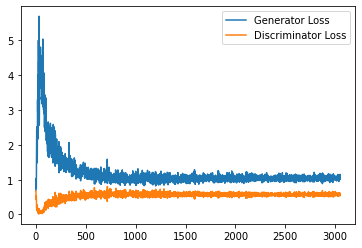

Step 61500: Generator loss: 1.0566333051919936, discriminator loss: 0.5763102396726608


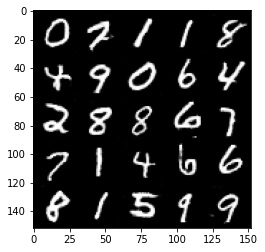

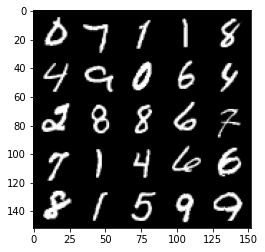

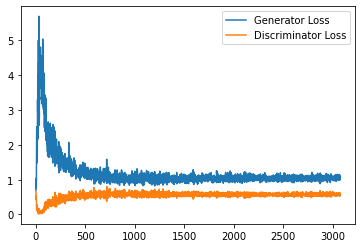

Step 62000: Generator loss: 1.0696339068412781, discriminator loss: 0.5784222771525382


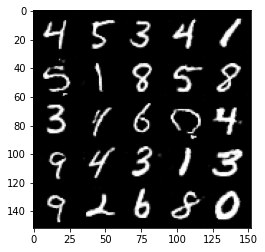

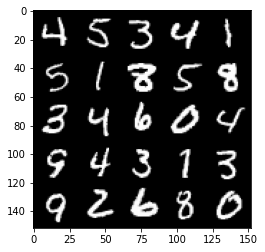

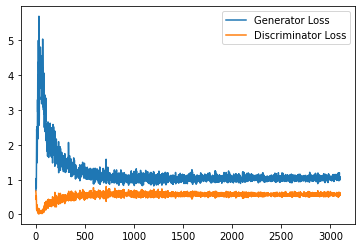

Step 62500: Generator loss: 1.0448249170780182, discriminator loss: 0.5728143908977509


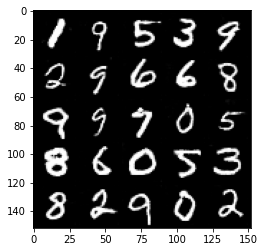

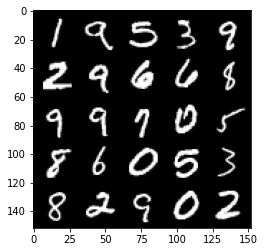

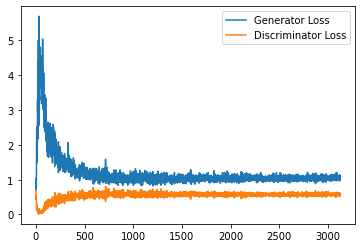

Step 63000: Generator loss: 1.0477914943695068, discriminator loss: 0.5757878231406212


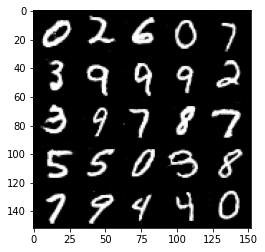

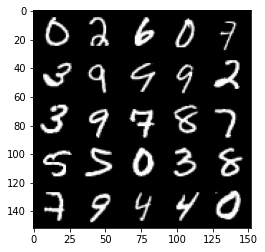

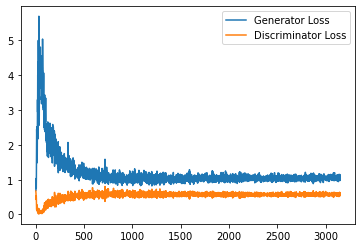

Step 63500: Generator loss: 1.0612971134185791, discriminator loss: 0.5716073142886162


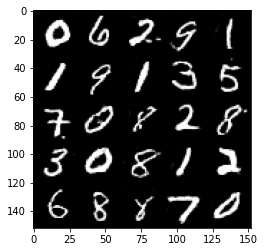

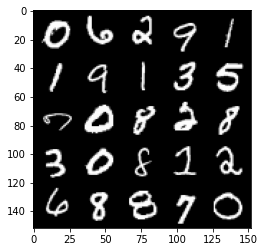

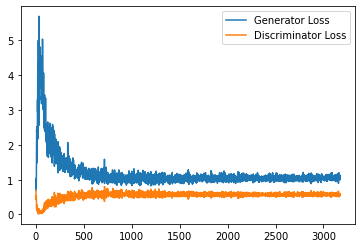

Step 64000: Generator loss: 1.050866093158722, discriminator loss: 0.5791512916088104


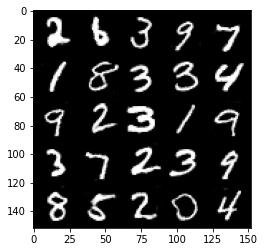

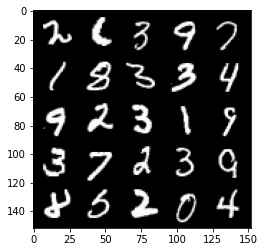

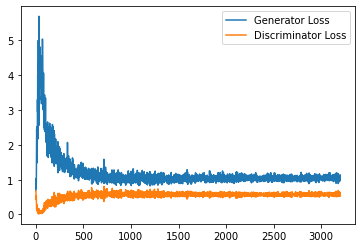

Step 64500: Generator loss: 1.058743062376976, discriminator loss: 0.5747852618694306


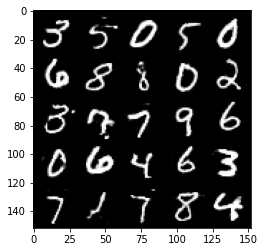

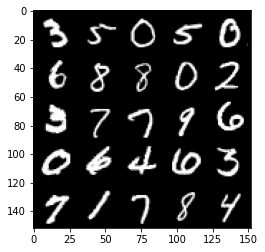

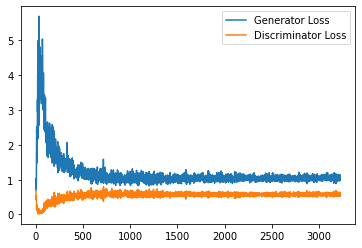

Step 65000: Generator loss: 1.0464242339134215, discriminator loss: 0.5767578772306442


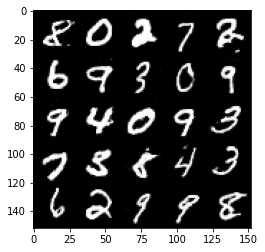

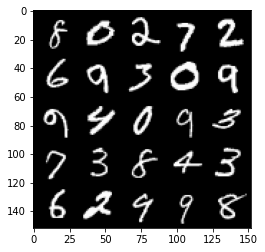

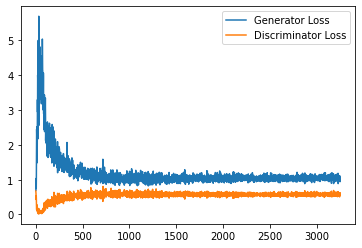

Step 65500: Generator loss: 1.049207014322281, discriminator loss: 0.5774809463620186


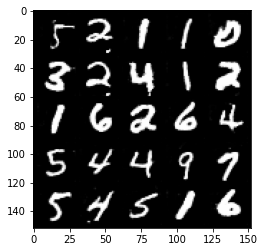

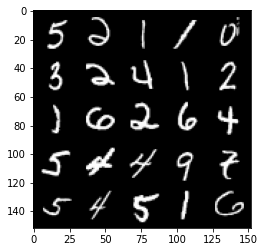

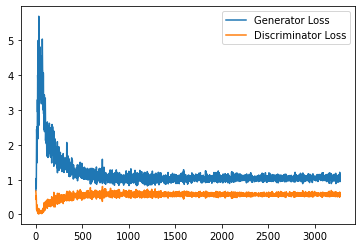

Step 66000: Generator loss: 1.0489647336006165, discriminator loss: 0.5771419531106949


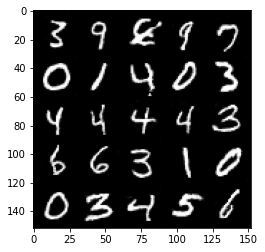

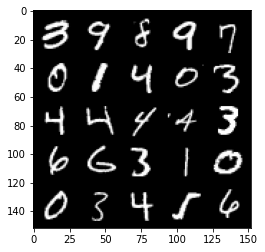

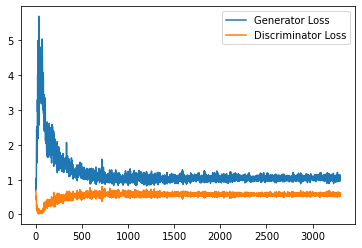

Step 66500: Generator loss: 1.0447473418712616, discriminator loss: 0.5730378787517547


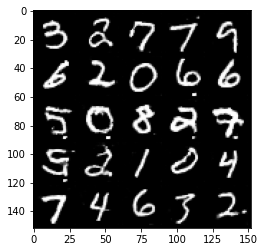

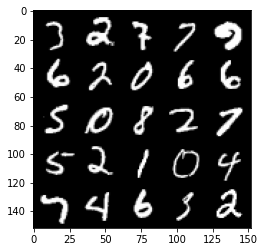

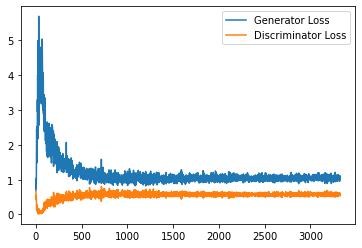

Step 67000: Generator loss: 1.0580059591531754, discriminator loss: 0.5755960524678231


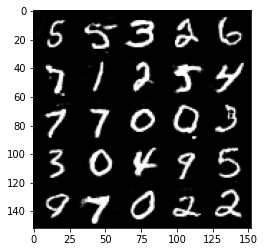

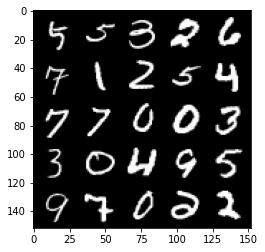

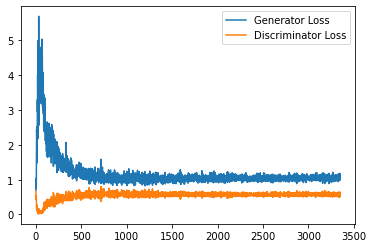

Step 67500: Generator loss: 1.0509240152835846, discriminator loss: 0.5743536080121994


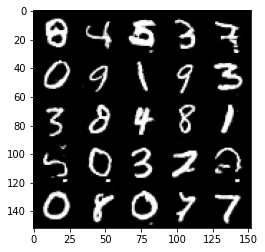

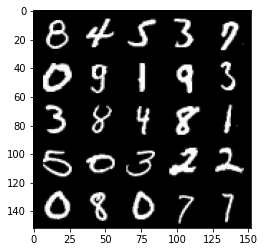

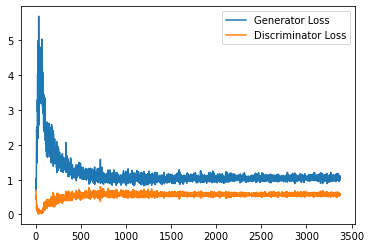

Step 68000: Generator loss: 1.0662047058343886, discriminator loss: 0.5728647685050965


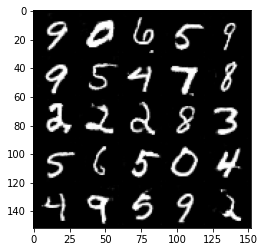

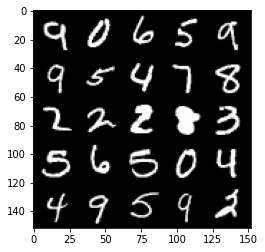

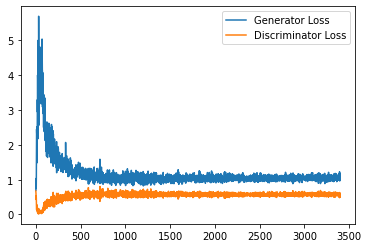

Step 68500: Generator loss: 1.0652408106327056, discriminator loss: 0.5765898718833923


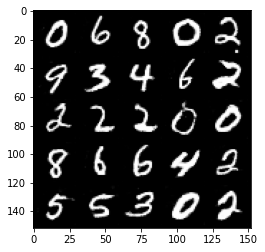

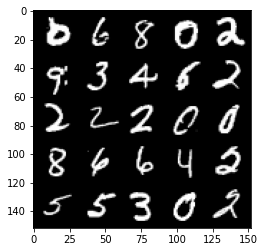

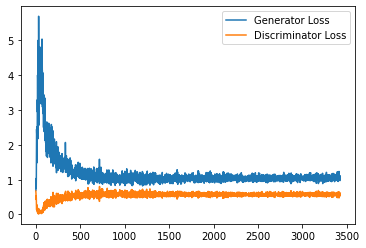

Step 69000: Generator loss: 1.0534470609426498, discriminator loss: 0.577281053185463


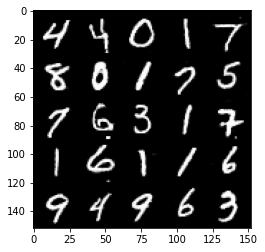

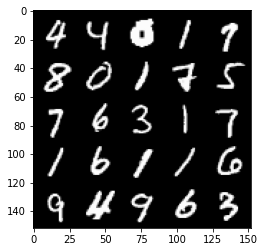

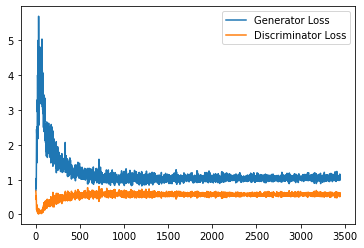

Step 69500: Generator loss: 1.0678106083869934, discriminator loss: 0.5781096625328064


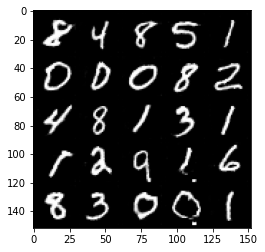

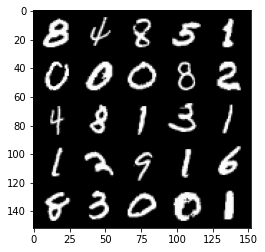

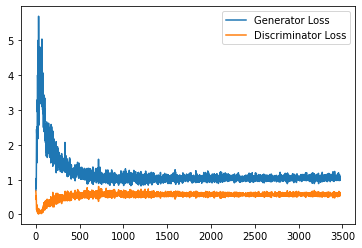

Step 70000: Generator loss: 1.0698350802659988, discriminator loss: 0.5737877985239029


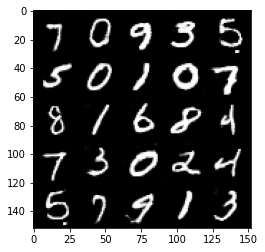

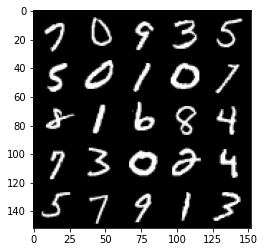

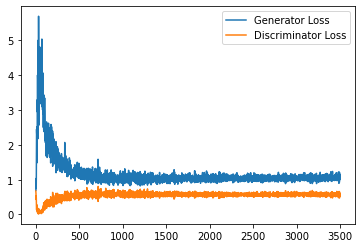

Step 70500: Generator loss: 1.0431245927810668, discriminator loss: 0.5772145783305168


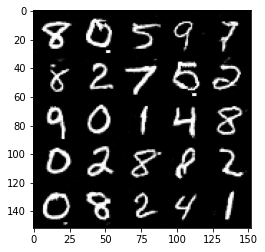

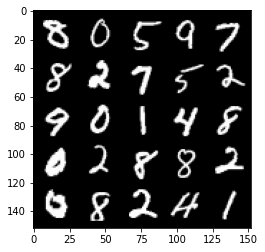

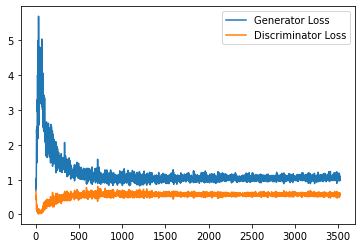

Step 71000: Generator loss: 1.0691249344348908, discriminator loss: 0.5764340236186981


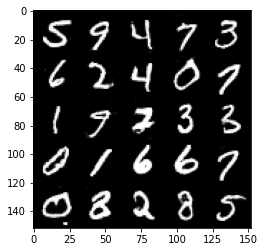

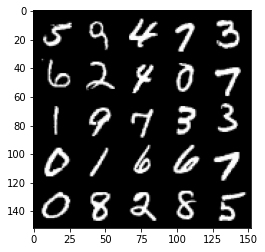

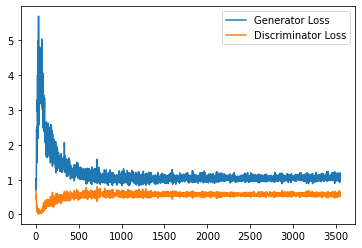

Step 71500: Generator loss: 1.0581838827133179, discriminator loss: 0.5793298543095589


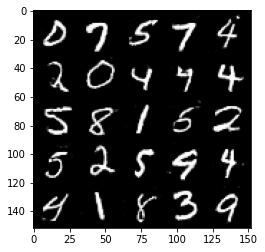

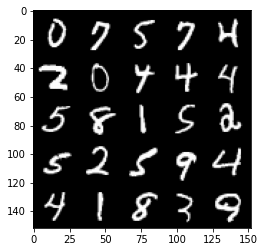

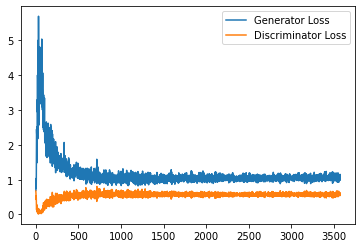

Step 72000: Generator loss: 1.0579070736169816, discriminator loss: 0.578173376083374


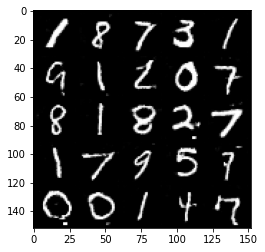

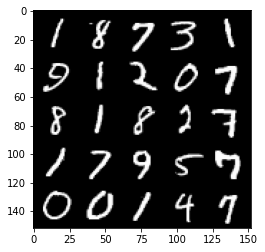

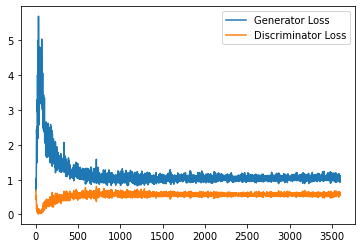

Step 72500: Generator loss: 1.0584469306468964, discriminator loss: 0.5712291926741601


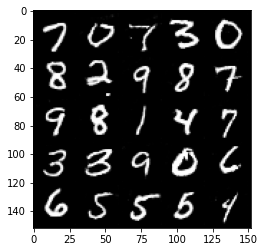

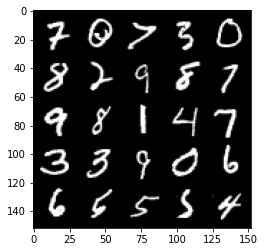

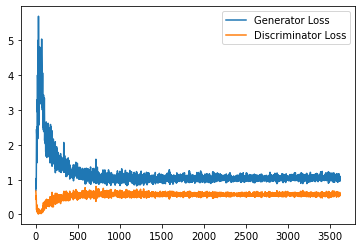

Step 73000: Generator loss: 1.0829289696216584, discriminator loss: 0.576466139793396


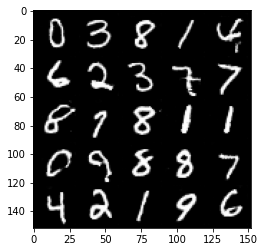

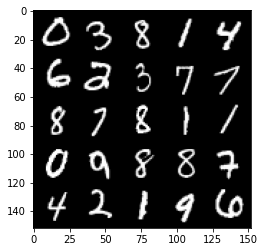

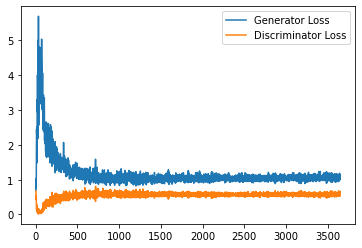

Step 73500: Generator loss: 1.0827425895929337, discriminator loss: 0.5737744669914245


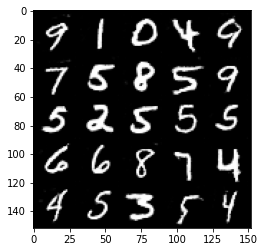

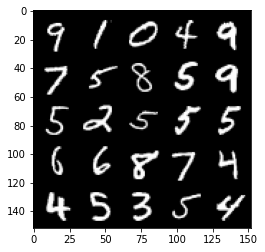

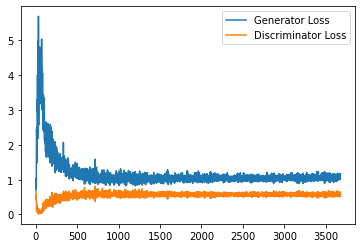

Step 74000: Generator loss: 1.0627963565587997, discriminator loss: 0.5751634312868118


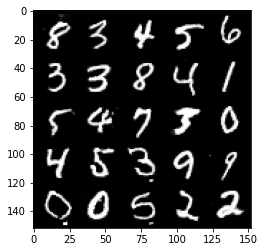

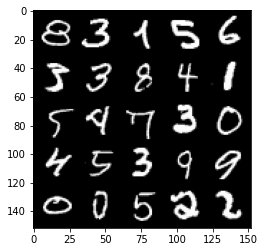

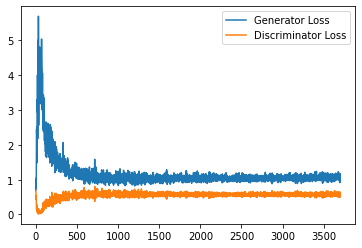

Step 74500: Generator loss: 1.0520273236036302, discriminator loss: 0.5730916648507118


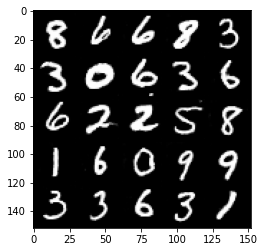

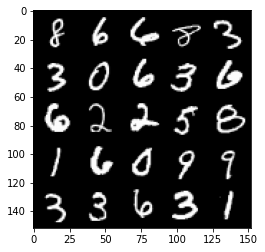

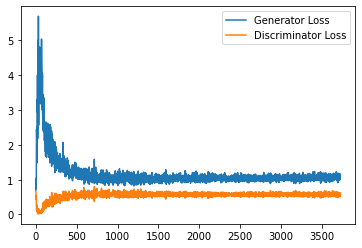

Step 75000: Generator loss: 1.0655544641017913, discriminator loss: 0.5771256038546562


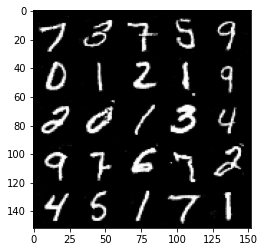

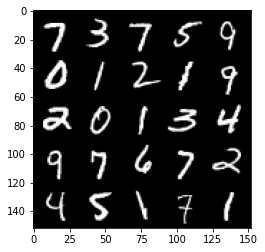

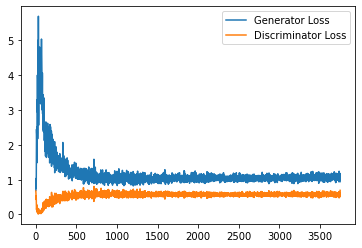

Step 75500: Generator loss: 1.080078973531723, discriminator loss: 0.5744429171681404


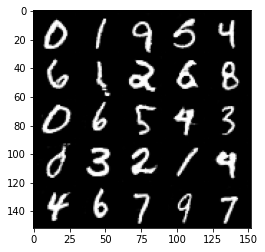

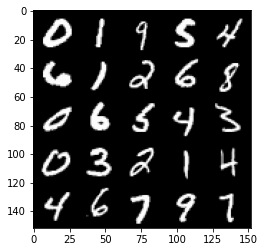

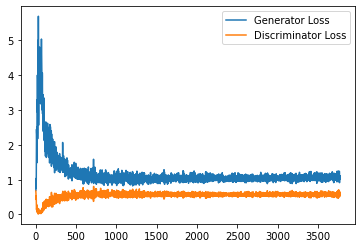

Step 76000: Generator loss: 1.058641925930977, discriminator loss: 0.5805613707304


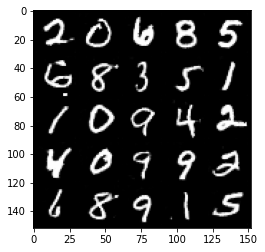

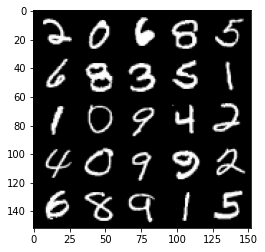

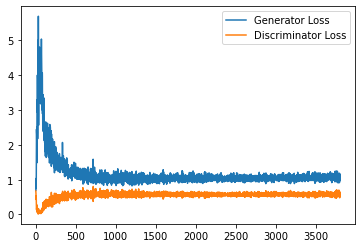

Step 76500: Generator loss: 1.0484228994846343, discriminator loss: 0.5767529045939446


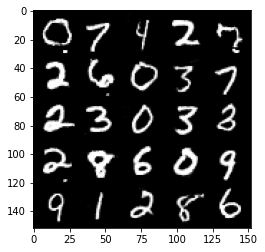

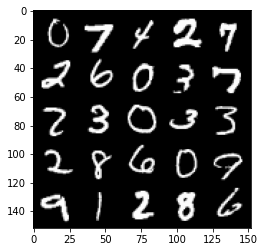

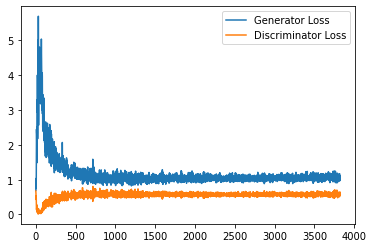

Step 77000: Generator loss: 1.0498977984189988, discriminator loss: 0.5794065662622452


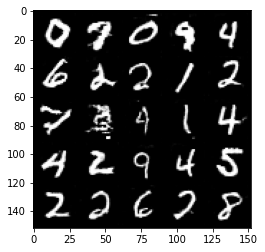

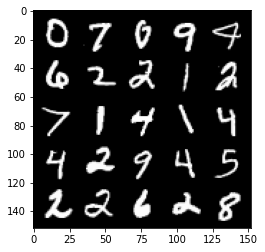

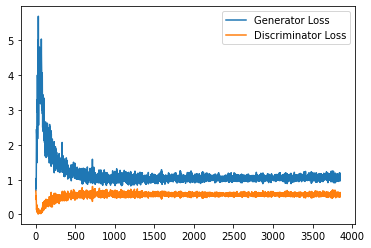

Step 77500: Generator loss: 1.0508632464408874, discriminator loss: 0.574550106048584


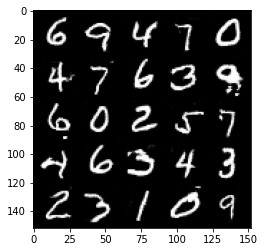

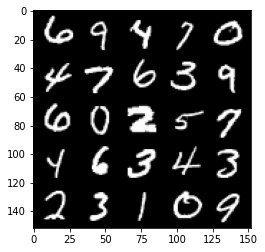

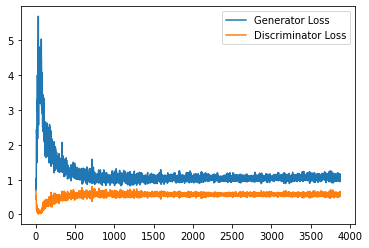

Step 78000: Generator loss: 1.062777415394783, discriminator loss: 0.5774096018671989


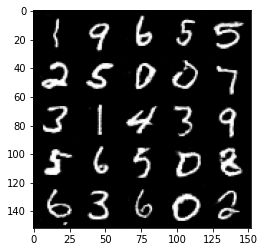

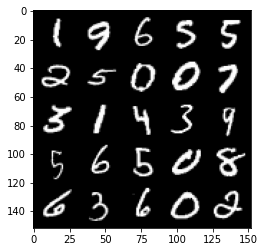

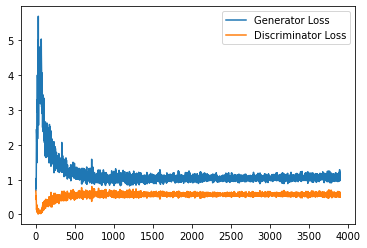

Step 78500: Generator loss: 1.0597577121257782, discriminator loss: 0.580099883377552


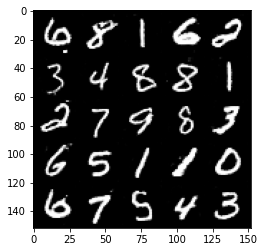

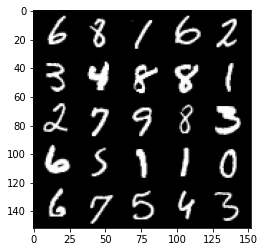

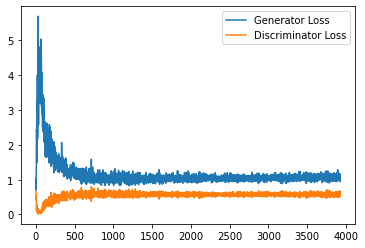

Step 79000: Generator loss: 1.0592332181930542, discriminator loss: 0.5735964678525924


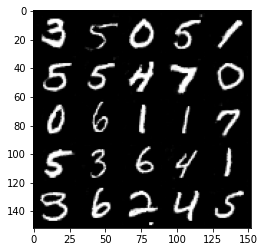

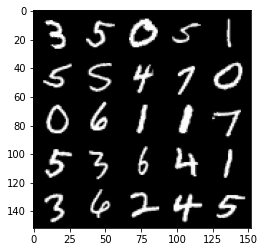

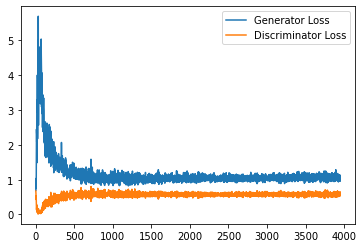

Step 79500: Generator loss: 1.0757908803224563, discriminator loss: 0.5718789452314377


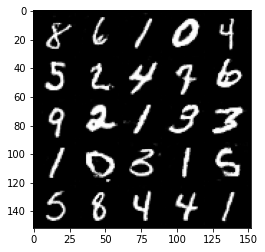

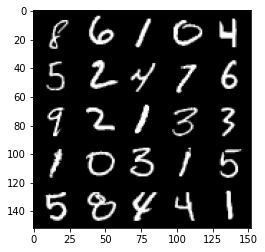

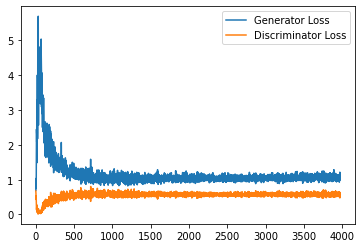

Step 80000: Generator loss: 1.067306885242462, discriminator loss: 0.574675830423832


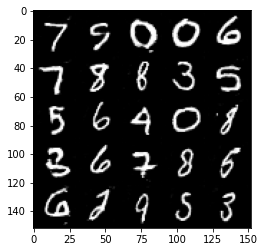

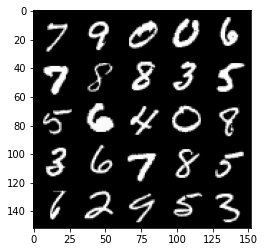

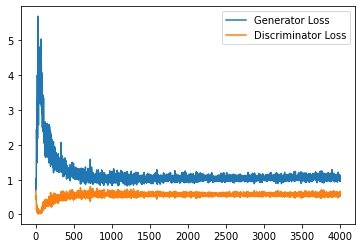

Step 80500: Generator loss: 1.0418373545408248, discriminator loss: 0.5788163492679596


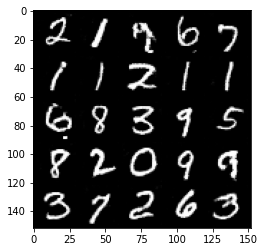

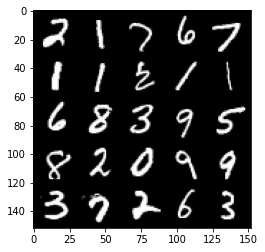

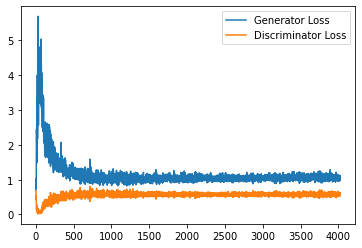

Step 81000: Generator loss: 1.0604593288898467, discriminator loss: 0.5717312704324722


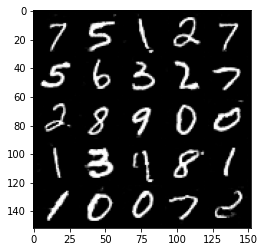

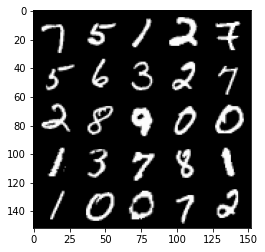

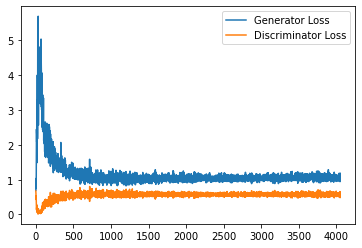

Step 81500: Generator loss: 1.0591723474264145, discriminator loss: 0.5807443119883537


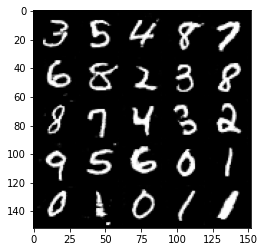

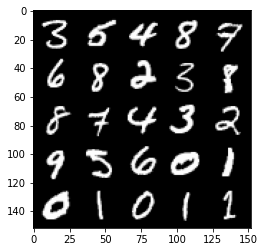

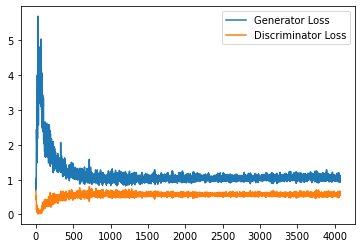

Step 82000: Generator loss: 1.058323070526123, discriminator loss: 0.5786596123576164


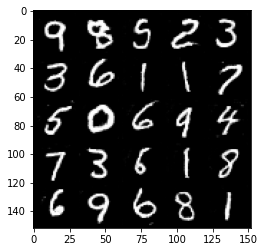

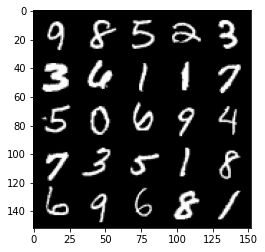

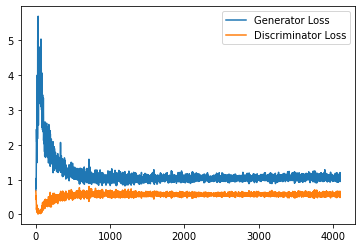

Step 82500: Generator loss: 1.0657027995586394, discriminator loss: 0.5743931688666344


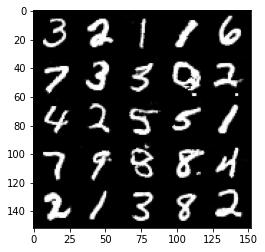

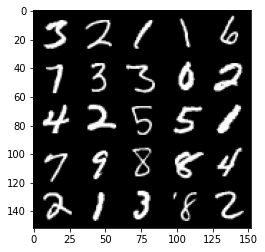

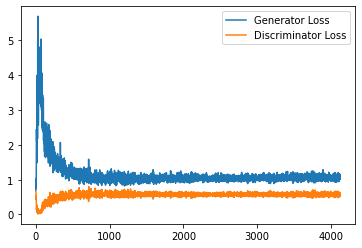

Step 83000: Generator loss: 1.072209538936615, discriminator loss: 0.5813101574778556


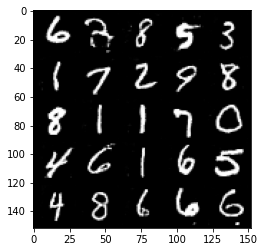

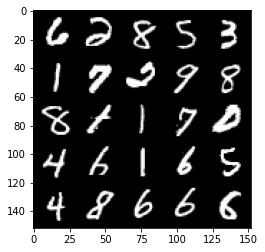

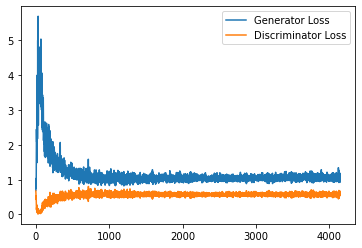

Step 83500: Generator loss: 1.045964262008667, discriminator loss: 0.5802924066781998


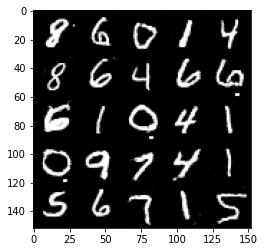

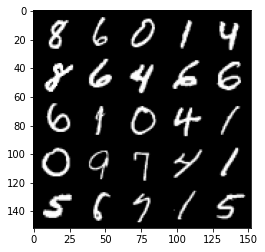

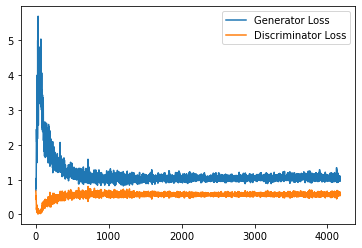

Step 84000: Generator loss: 1.0477857209444046, discriminator loss: 0.5806200283169747


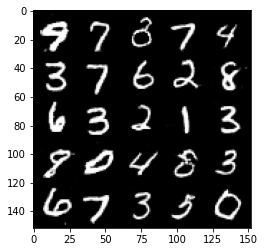

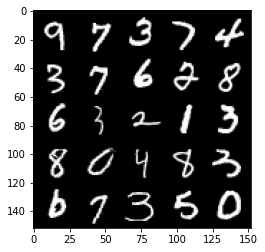

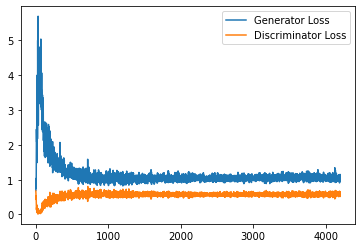

Step 84500: Generator loss: 1.0424381141662598, discriminator loss: 0.5810260801315308


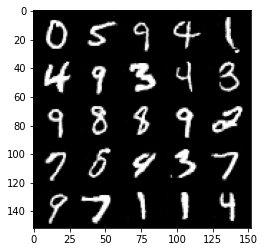

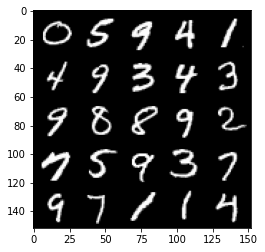

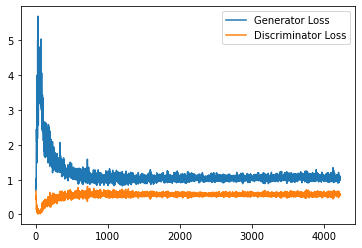

Step 85000: Generator loss: 1.0590229448080062, discriminator loss: 0.582346782207489


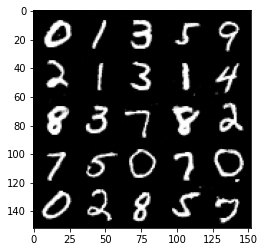

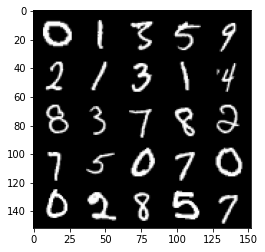

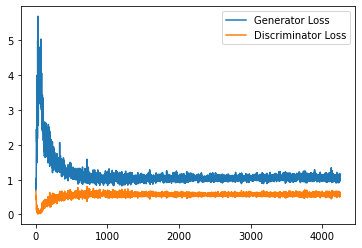

Step 85500: Generator loss: 1.0770077549219133, discriminator loss: 0.5852754467725754


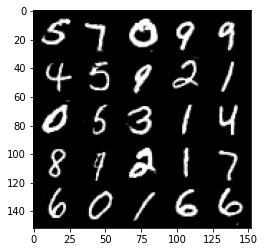

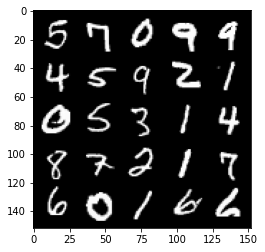

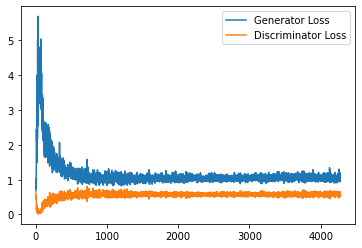

Step 86000: Generator loss: 1.0347042242288589, discriminator loss: 0.5868609782457351


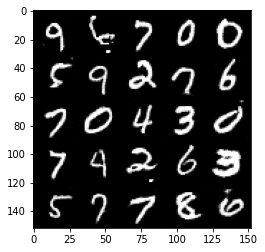

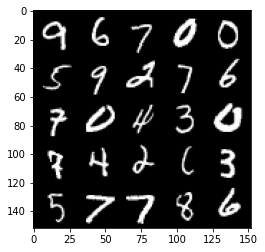

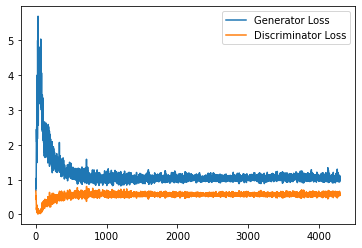

Step 86500: Generator loss: 1.03911924803257, discriminator loss: 0.5800460307598114


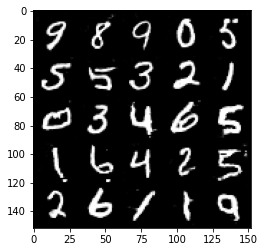

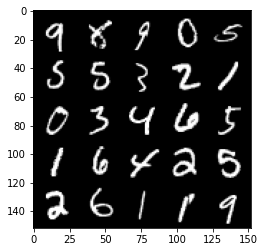

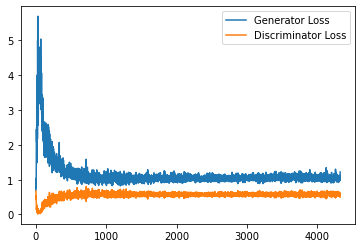

Step 87000: Generator loss: 1.0374956218004228, discriminator loss: 0.5882062563300132


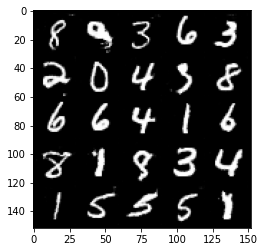

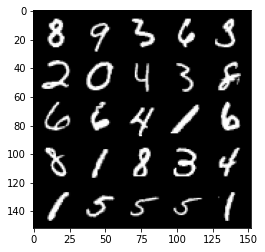

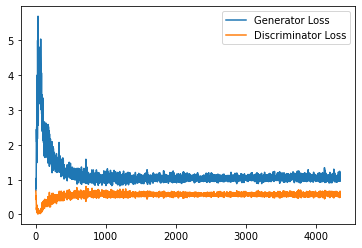

Step 87500: Generator loss: 1.0551379145383835, discriminator loss: 0.5851050671935082


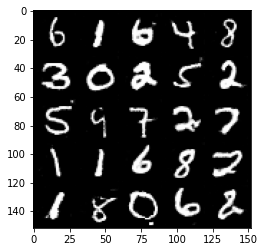

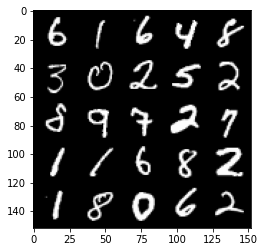

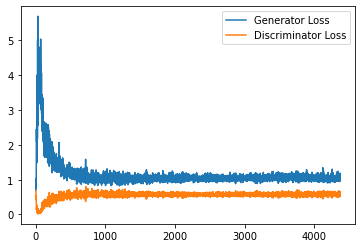

Step 88000: Generator loss: 1.05356434237957, discriminator loss: 0.597754084944725


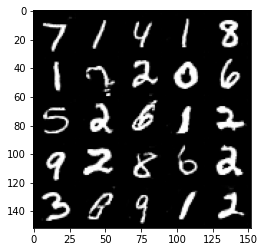

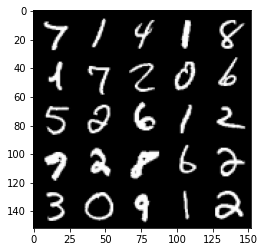

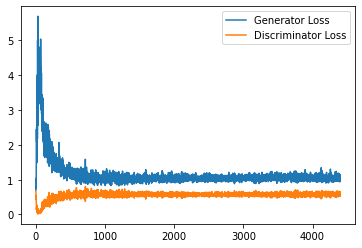

Step 88500: Generator loss: 1.024943316578865, discriminator loss: 0.5926150598526001


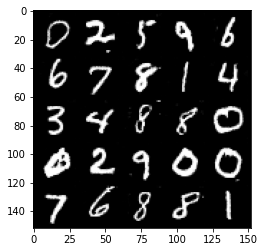

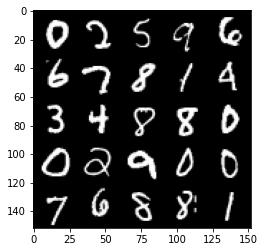

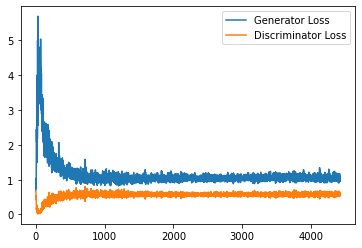

Step 89000: Generator loss: 1.032610271692276, discriminator loss: 0.5952772597670555


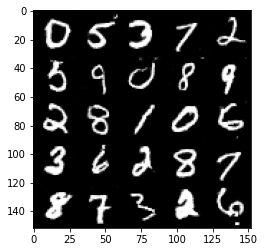

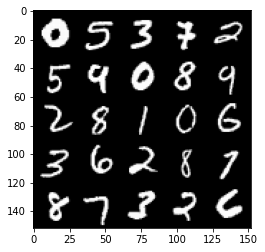

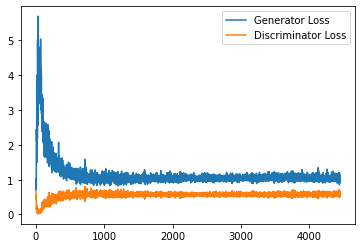

Step 89500: Generator loss: 1.028175952911377, discriminator loss: 0.5891064329147339


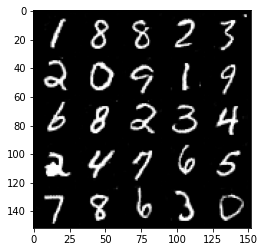

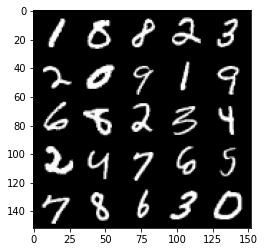

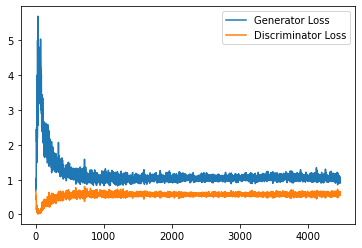

Step 90000: Generator loss: 1.0205302593708039, discriminator loss: 0.5913414447903633


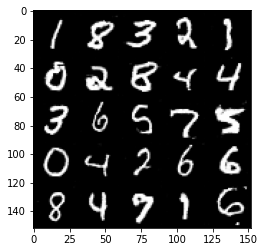

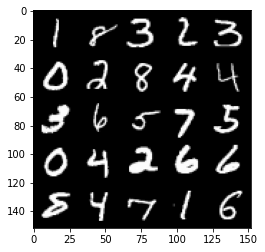

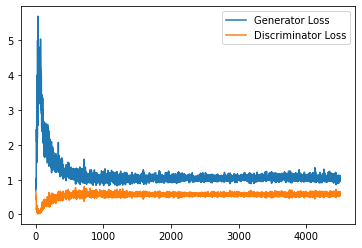

Step 90500: Generator loss: 1.0481864069700242, discriminator loss: 0.5995193707942963


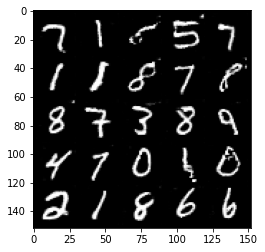

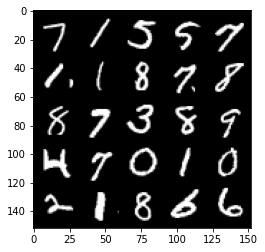

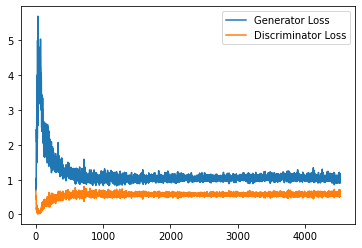

Step 91000: Generator loss: 1.0292234930992126, discriminator loss: 0.5963505165576934


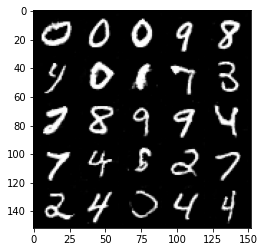

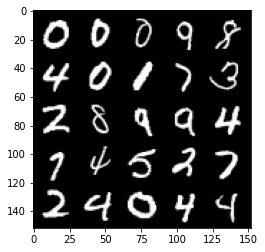

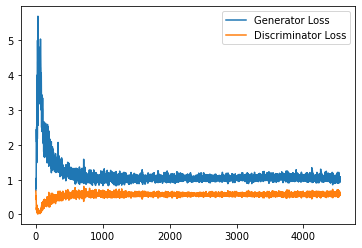

Step 91500: Generator loss: 1.0202436261177064, discriminator loss: 0.5941169599294662


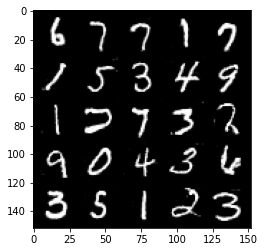

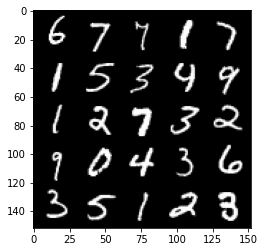

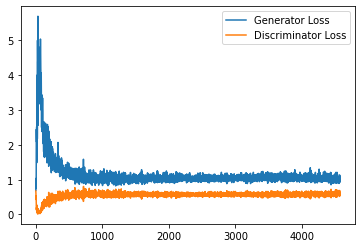

Step 92000: Generator loss: 1.0264355307817459, discriminator loss: 0.5978839600682259


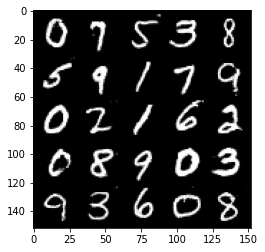

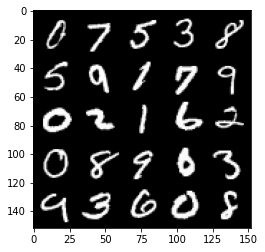

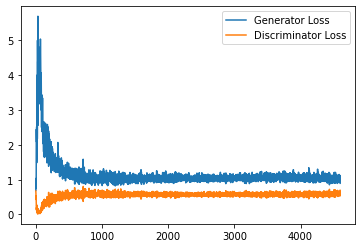

Step 92500: Generator loss: 1.045698281764984, discriminator loss: 0.590704255104065


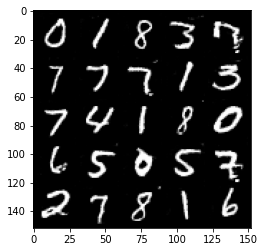

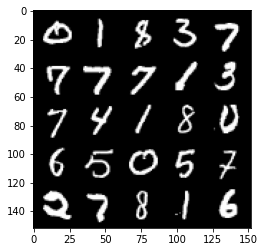

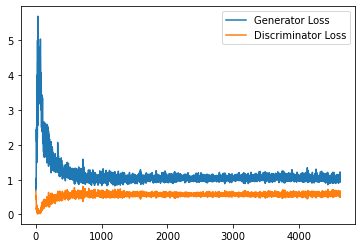

Step 93000: Generator loss: 1.0292828909158707, discriminator loss: 0.5993032655119896


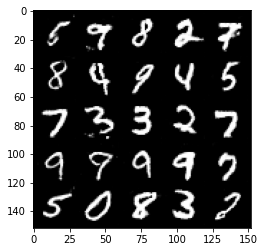

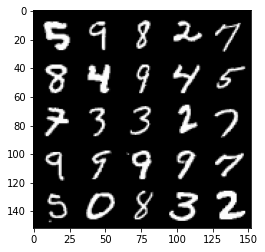

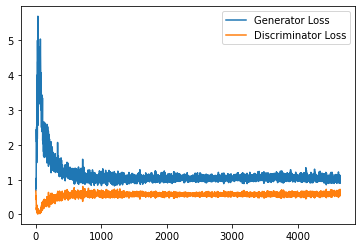

Step 93500: Generator loss: 1.0246110929250718, discriminator loss: 0.5981898360848427


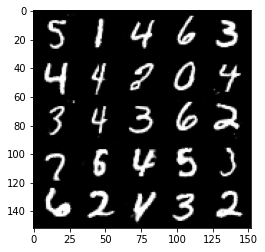

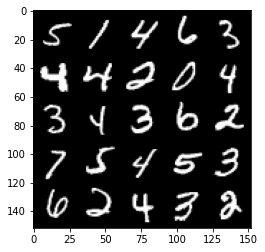

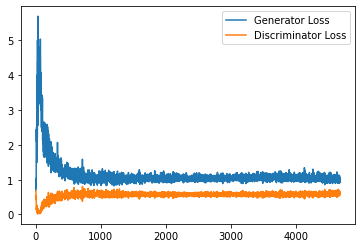

In [20]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [21]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

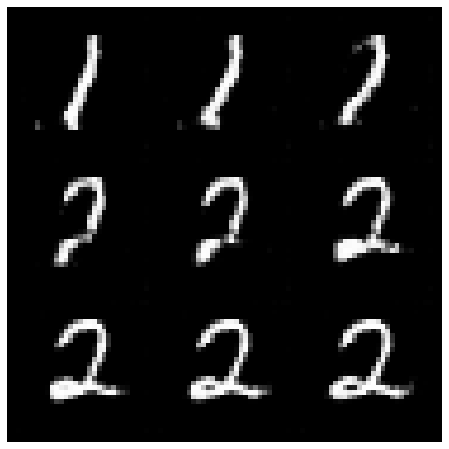

In [24]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 2 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

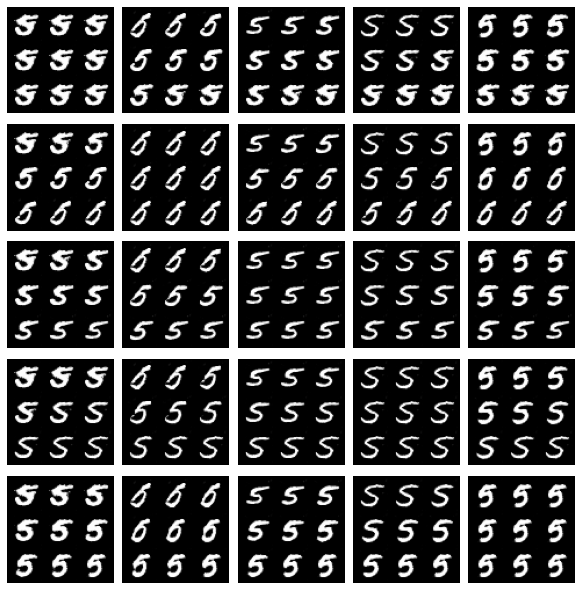

In [25]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()